# Import Libraries

Import necessary libraries to start initial importing of data and plotting libraries.  The functions library is a python helper file that I wrote to import all the class functions.  The Stats function does a comparison of datasets distributions and finds if normal or not and then run the appropriate test for comparison.  The dataProcessing class pre-processes the data and add features using feature engineering.  Additionally it will remove outliers and put the label at the end of the dataframe.  Finally the Models class iterates through models and parameters and returns a dataframe with the models results. 

In [1]:
import warnings
warnings.filterwarnings('ignore')

import functions as fn

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import cufflinks as cf
cf.set_config_file(offline=True)

from pandas_profiling import ProfileReport

## Pandas Settings

Setup the initial setting used for pandas in the notebook.

In [2]:
pd.options.display.float_format = '{:.4f}'.format
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 100)

## Set Initial Parameters

Set colors and start date that will be used in the entire notebook.

In [3]:
colorIreland = '#006400'
colorGermany = '#DAA520'
colorUSA  = '#3E6FB0'

startDate = '1992-01-01'
endDate = '2020-12-31'

## Functions 

Some initial functions that will be used in the formating of dates in the notebook. 

In [4]:
def formatDates(data, position):
    '''This method converts the day of the month to the first date in the dataframe.
    When resampling dates the dates can be all over the place.  This is important
    when merging dataframes.

    Args:
    data (data frame): The dataset with datetime columns.
    position (int): This is the number of column the datetime column is in the dataframe.

    Returns:
    dates (string array): datetime string array that will be converted into datetime.

    Notes: 
    '''
    dates = []
    for index, row in data.iterrows():
        # Iterate through each row and append the 01 for first of the month date.
        dates.append(str(row[position])[:8] + '01')
    return dates

def resampleMonthly(data, dateColumn, dateLocation, method):
    '''This method resamples annual dataframe into monthly.  This is upsampling
    and the method used to upsample will be to interpolate and user states method
    to interpolate.  This does create a linear number in your dataset but could 
    have issues with leakage.

    Args:
    data (data frame): The dataset containing dataframe to be resampled.
    dateColumn (string): Name of the date column to be resampled.
    dateLocation (int): This is the number of column the datetime column is in the dataframe.
    on (string): This is the name of column the datetime column is to be resampled.
    method (string): 

    Returns:
    data (data frame): The dataframe resampled with new dates.

    Notes: 
    https://www.geeksforgeeks.org/how-to-resample-time-series-data-in-python/
    '''
    df = data.resample('M', on=dateColumn).mean().interpolate(method=method)
    df.reset_index(inplace=True)
    df[dateColumn] = formatDates(df, dateLocation)
    df[dateColumn] = pd.to_datetime(df[dateColumn])
    df.sort_values(dateColumn, inplace=True)
    df.set_index(dateColumn,inplace=True)
    return df

# All EU Dataset

Import the dataset from the EU that contains all the countries and production of livestock.  Here the dataset needs to be filtered for only for tonnes and further filtering of the time, location, meat and value.  Columns renames and then date formated and filter for dates from start date.  Country column will only get the name of the country needed.  Additionally remove any colons from dataset and ensure that value column is a float.  Once all done reset index and print. 

https://ec.europa.eu/eurostat/estat-navtree-portlet-prod/BulkDownloadListing?file=data/apro_mt_pwgtm.tsv.gz

In [5]:
# https://ec.europa.eu/eurostat/estat-navtree-portlet-prod/BulkDownloadListing?file=data/apro_mt_pwgtm.tsv.gz
EUdata = pd.read_csv('data/apro_mt_pwgtm_1_Data.csv')
EUdata = EUdata[EUdata['UNIT'] == 'Thousand tonnes']
EUdata = EUdata[['TIME', 'GEO', 'MEAT', 'Value']]
EUdata.columns = ['Date', 'Country', 'Meat', 'Value']

EUdata.Date = pd.to_datetime(EUdata.Date, format='%YM%m')
EUdata = EUdata[(EUdata.Date >= startDate) & (EUdata.Date <= endDate)]

EUdata['Country'] = EUdata['Country'].str.slice(0,7)
EUdata = EUdata.replace([':'], 0, regex=True)
EUdata['Value'] = EUdata['Value'].astype(float)

EUdata.reset_index(inplace=True, drop=True)
EUdata

,Date,Country,Meat,Value
0,1992-01-01,Germany,Bovine meat,159.1700
1,1992-01-01,Germany,Pigmeat,323.2400
2,1992-01-01,Germany,Sheepmeat,2.9100
3,1992-01-01,Germany,Poultry meat,0.0000
4,1992-01-01,Ireland,Bovine meat,35.0000
...,...,...,...,...
2779,2020-12-01,Germany,Poultry meat,140.0000
2780,2020-12-01,Ireland,Bovine meat,48.3900
2781,2020-12-01,Ireland,Pigmeat,25.6500
2782,2020-12-01,Ireland,Sheepmeat,5.5000


In [6]:
# Verify dtypes
EUdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2784 entries, 0 to 2783
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Date     2784 non-null   datetime64[ns]
 1   Country  2784 non-null   object        
 2   Meat     2784 non-null   object        
 3   Value    2784 non-null   float64       
dtypes: datetime64[ns](1), float64(1), object(2)
memory usage: 87.1+ KB


# Ireland Slaughter Data

Now filtering from the EU dataset Ireland data only.  Poultry will not be used as Ireland has many missing values for years of counts.  Dataframe is then pivoted to show years as index and meats as columns and values in the dataframe.  Sort the dataframe on dates and rename columns to be consistent.

In [7]:
irelandData = EUdata[EUdata['Country'] == 'Ireland'].reset_index(drop=True)
irelandData = irelandData[irelandData.Meat != 'Poultry meat']
irelandData = irelandData.pivot_table(index='Date', columns='Meat', values='Value')
irelandData.reset_index(inplace=True)
irelandData.sort_values('Date', inplace=True, ascending= True)
irelandData.set_index('Date',inplace=True)

irelandData.columns = ['Ireland Bovine Meat', 'Ireland Pig Meat', 'Ireland Lamb Meat']
irelandData

,Ireland Bovine Meat,Ireland Pig Meat,Ireland Lamb Meat
Date,,,
1992-01-01,35.0000,17.9000,6.5000
1992-02-01,31.9000,15.0000,5.3000
1992-03-01,46.7000,16.5000,4.7000
1992-04-01,40.0000,16.0000,5.9000
1992-05-01,33.8000,15.9000,7.9000
...,...,...,...
2020-08-01,52.3200,24.9400,5.1100
2020-09-01,55.6300,27.5900,6.3100
2020-10-01,57.5800,27.5100,6.1300


## Ireland Data NaN Count

In [8]:
# Verify no NaN count
irelandData.isna().sum()

Ireland Bovine Meat    0
Ireland Pig Meat       0
Ireland Lamb Meat      0
dtype: int64

## Ireland Dtypes

In [9]:
# Verify dtypes
irelandData.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 348 entries, 1992-01-01 to 2020-12-01
Data columns (total 3 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Ireland Bovine Meat  348 non-null    float64
 1   Ireland Pig Meat     348 non-null    float64
 2   Ireland Lamb Meat    348 non-null    float64
dtypes: float64(3)
memory usage: 10.9 KB


## Ireland Data Box Plot

In [10]:
fig = px.box(irelandData, points='all')
fig.update_layout(title_text='Livestock Slaughterings Ireland', 
                  title_x=0.5, legend_title='Livestock')
fig.update_traces(marker_color=colorIreland)
fig.show();

## Ireland Slaughter Plot

In [11]:
fig = px.line(irelandData, labels={'value': 'Tonne in thousands',
                    'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Ireland', 
                  title_x=0.5, legend_title='Livestock')
fig.show()

## Ireland Slaughter Growth Plot

In [12]:
(irelandData.iloc[-1] - irelandData.iloc[0]) / irelandData.iloc[0]

Ireland Bovine Meat    0.3826
Ireland Pig Meat       0.4330
Ireland Lamb Meat     -0.1538
dtype: float64

In [13]:
fig = px.line(((1 + irelandData.pct_change()).cumprod() - 1).dropna(),
             labels={'value': 'Percentage Growth',
                    'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Growth Ireland Since 1992', 
                  title_x=0.5, legend_title='Livestock')
fig.show()

## Ireland Monthly Variance Plot

In [14]:
fig = px.bar(irelandData[200:-1].pct_change()['Ireland Bovine Meat'], 
             labels={'value': 'Percentage Growth', 'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Growth Ireland Since 2010', 
                  title_x=0.5, legend_title='Livestock')
fig.update_traces(marker_color=colorIreland)
fig.show()

In [15]:
fig = px.line(irelandData[['Ireland Bovine Meat', 'Ireland Pig Meat', 
                           'Ireland Lamb Meat']].pct_change(), 
              labels={'value': 'Tonne in thousands',
                    'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Ireland Month to Month Variance Since 1992', 
                  title_x=0.5, legend_title='Livestock')
fig.show()

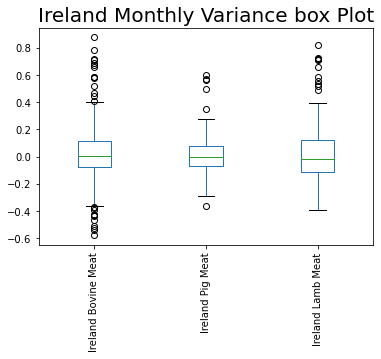

In [16]:
irelandData[['Ireland Bovine Meat', 'Ireland Pig Meat', 
                           'Ireland Lamb Meat']].pct_change().plot(kind='box', rot=90)
plt.title("Ireland Monthly Variance box Plot", fontsize=20);

# Germany Slaughter Data

Now filtering from the EU dataset German data only. Dataframe is then pivoted to show years as index and meats as columns and values in the dataframe.  Sort the dataframe on dates and rename columns to be consistent.

In [17]:
germanData = EUdata[EUdata['Country'] == 'Germany'].reset_index(drop=True)
germanData = germanData[germanData.Meat != 'Poultry meat']
germanData = germanData.pivot_table(index='Date', columns='Meat', values='Value')
germanData.sort_values('Date', inplace=True, ascending= True)
germanData.reset_index(inplace=True)
germanData.set_index('Date',inplace=True)
germanData.columns = ['Germany Bovine Meat', 'Germany Pig Meat', 'Germany Lamb Meat']
germanData

,Germany Bovine Meat,Germany Pig Meat,Germany Lamb Meat
Date,,,
1992-01-01,159.1700,323.2400,2.9100
1992-02-01,140.1100,285.4000,2.5200
1992-03-01,164.5400,316.9800,3.1600
1992-04-01,155.6100,297.4600,3.6500
1992-05-01,144.8200,300.1500,2.7000
...,...,...,...
2020-08-01,85.0000,422.0000,2.0000
2020-09-01,94.0000,437.0000,2.0000
2020-10-01,103.0000,432.0000,2.0000


## Germany NaN Count

In [18]:
germanData.isna().sum()

Germany Bovine Meat    0
Germany Pig Meat       0
Germany Lamb Meat      0
dtype: int64

## German Dtypes

In [19]:
germanData.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 348 entries, 1992-01-01 to 2020-12-01
Data columns (total 3 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Germany Bovine Meat  348 non-null    float64
 1   Germany Pig Meat     348 non-null    float64
 2   Germany Lamb Meat    348 non-null    float64
dtypes: float64(3)
memory usage: 10.9 KB


## Germany Data Box Plot

In [20]:
fig = px.box(germanData, points='all')
fig.update_layout(title_text='Livestock Slaughterings Germany', 
                  title_x=0.5, legend_title='Livestock')
fig.update_traces(marker_color=colorGermany)
fig.show()

## Germany Slaughter Plot

In [21]:
fig = px.line(germanData, labels={'value': 'Tonne in thousands',
                    'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Germany', 
                  title_x=0.5, legend_title='Livestock')
fig.show()

## Germany Slaughter Growth Plot

In [22]:
(germanData.iloc[-2] - germanData.iloc[0]) / germanData.iloc[0]

Germany Bovine Meat   -0.3843
Germany Pig Meat       0.3581
Germany Lamb Meat     -0.3127
dtype: float64

In [23]:
fig = px.line(((1 + germanData.pct_change()).cumprod() - 1),
             labels={'value': 'Percentage Growth',
                    'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Growth Germany', 
                  title_x=0.5, legend_title='Livestock')
fig.show()

## Germany Monthly Variance Plot

In [24]:
# Month to month Bar plot
fig = px.bar(germanData[200:].pct_change()['Germany Bovine Meat'], 
             labels={'value': 'Percentage Growth', 'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Growth Germany Since 2010', 
                  title_x=0.5, legend_title='Livestock')
fig.update_traces(marker_color=colorGermany)
fig.show()

In [25]:
# Month to month line plot
fig = px.line(germanData[['Germany Bovine Meat', 'Germany Pig Meat', 
                           'Germany Lamb Meat']].pct_change(), 
              labels={'value': 'Tonne in thousands',
                    'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Germany Month to Month Variance Since 1992', 
                  title_x=0.5, legend_title='Livestock')
fig.show()

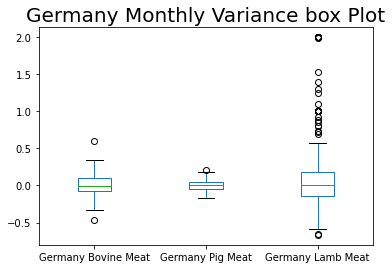

In [26]:
germanData[['Germany Bovine Meat', 'Germany Pig Meat', 
                           'Germany Lamb Meat']].pct_change().plot(kind='box')
plt.title("Germany Monthly Variance box Plot", fontsize=20);

# USA Slaughter Data

Dataset was downloaded from the USDA website and selecting the right tab for weights of slaughterings. Importing the dates and right sheet in spreadsheet was a bit of challenge.  Dropping the last rows that explain and dropping non needed columns.  Could have done keep columns instead but that is the way I went.  Convert date column to datetime and then filter only dates needed and finally sorting and casting dtype. 

https://www.ers.usda.gov/data-products/livestock-and-meat-domestic-data/livestock-and-meat-domestic-data/#All%20Meat%20Statistics

In [27]:
#https://www.ers.usda.gov/data-products/livestock-and-meat-domestic-data/livestock-and-meat-domestic-data/#All%20Meat%20Statistics
usaData = pd.read_excel('data/MeatStatsFullUSA.xlsx', sheet_name='RedMeatPoultry_Prod-Full',
                   skiprows=1, parse_dates=['Type 1/'])
usaData.drop(usaData.tail(9).index, inplace=True)
usaData.drop(usaData.columns[[1,2,3,4,5,6,8,11,12,13,14,15, 16,17]], axis=1, inplace=True)
usaData.columns=['Date','USA Bovine Meat', 'USA Pig Meat', 'USA Lamb Meat']
usaData.drop(usaData.head(3).index, inplace=True)
usaData.Date = pd.to_datetime(usaData.Date, format='%b-%Y')
usaData = usaData[(usaData.Date >= startDate) & (usaData.Date <= endDate)].reset_index(drop=True)
usaData.sort_values('Date', inplace=True, ascending=True)
usaData.set_index('Date', inplace=True)
usaData = usaData.astype(float)
usaData

,USA Bovine Meat,USA Pig Meat,USA Lamb Meat
Date,,,
1992-01-01,1998.0000,1491.0000,30.0000
1992-02-01,1671.0000,1300.0000,27.0000
1992-03-01,1812.0000,1436.0000,32.0000
1992-04-01,1751.0000,1385.0000,32.0000
1992-05-01,1867.0000,1261.0000,24.0000
...,...,...,...
2020-08-01,2298.0000,2326.8000,9.5000
2020-09-01,2315.3000,2322.5000,9.4000
2020-10-01,2431.9000,2585.8000,9.2000


## USA Data NaN Count

In [28]:
usaData.isna().sum()

USA Bovine Meat    0
USA Pig Meat       0
USA Lamb Meat      0
dtype: int64

## USA Dtypes

In [29]:
usaData.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 348 entries, 1992-01-01 to 2020-12-01
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   USA Bovine Meat  348 non-null    float64
 1   USA Pig Meat     348 non-null    float64
 2   USA Lamb Meat    348 non-null    float64
dtypes: float64(3)
memory usage: 10.9 KB


## USA Data Box Plot

In [30]:
#https://plotly.com/python/box-plots/
fig = px.box(usaData)
fig.update_layout(title_text='Livestock Slaughterings USA', 
                  title_x=0.5, legend_title='Livestock')
fig.update_traces(marker_color=colorUSA)
fig.show()

## Convert USA Data to Tonne

This extra step had to be done and glad I did as I verified how the data is collected and found that I was on the wrong sheet.  I was looking at average weight per slaughter.  What tipped me off as well is that the number did not change in 30 years.  US data is shown in million pounds and this has to be converted into kilos and then into metric kilos. The numbers were further verified on the FAO website and for 2019 production for USA bovine meat was 12.348 and summing converted data returned 12.165.  There is a small difference but is acceptable. 

https://www.convertunits.com/from/lbs/to/metric+ton

In [31]:
#First convert pounds into million then convert into kilos and finally into metric tonne
#https://www.convertunits.com/from/lbs/to/metric+ton
usaData = usaData * (1/2.2046226218488)
usaData

,USA Bovine Meat,USA Pig Meat,USA Lamb Meat
Date,,,
1992-01-01,906.2776,676.3062,13.6078
1992-02-01,757.9529,589.6701,12.2470
1992-03-01,821.9094,651.3586,14.5150
1992-04-01,794.2402,628.2254,14.5150
1992-05-01,846.8570,571.9800,10.8862
...,...,...,...
2020-08-01,1042.3553,1055.4187,4.3091
2020-09-01,1050.2024,1053.4683,4.2638
2020-10-01,1103.0913,1172.8992,4.1730


In [32]:
usaData[(usaData.index >= '2019-01-01')&(usaData.index <= '2019-12-01')].sum()

USA Bovine Meat   12165.9824
USA Pig Meat      12476.8292
USA Lamb Meat        60.7360
dtype: float64

## USA Slaughter Plot

In [33]:
fig = px.line(usaData, labels={'value': 'Tonne in thousands',
                    'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings USA', 
                  title_x=0.5, legend_title='Livestock')
fig.show()

## USA Slaughter Growth Plot

In [34]:
(usaData.iloc[-1] - usaData.iloc[0]) / usaData.iloc[0]

USA Bovine Meat    0.1470
USA Pig Meat       0.6763
USA Lamb Meat     -0.6433
dtype: float64

In [35]:
fig = px.line(((1 + usaData.pct_change()).cumprod() - 1),
             labels={'value': 'Percentage Growth',
                    'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Growth USA', 
                  title_x=0.5, legend_title='Livestock')
fig.show()

## USA Monthly Variance Plot

In [36]:
fig = px.bar(usaData[200:].pct_change()['USA Bovine Meat'], 
             labels={'value': 'Percentage Growth', 'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Growth Ireland', 
                  title_x=0.5, legend_title='Livestock')
fig.update_traces(marker_color=colorUSA)
fig.show()

In [37]:
# Month to month line plot
fig = px.line(usaData[['USA Bovine Meat', 'USA Pig Meat', 
                           'USA Lamb Meat']].pct_change(), 
              labels={'value': 'Tonne in thousands',
                    'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings USA Month to Month Variance Since 1992', 
                  title_x=0.5, legend_title='Livestock')
fig.show()

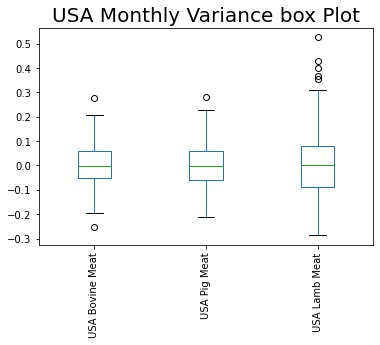

In [38]:
usaData[['USA Bovine Meat', 'USA Pig Meat', 
                           'USA Lamb Meat']].pct_change().plot(kind='box', rot=90)

plt.title("USA Monthly Variance box Plot", fontsize=20);

# Economic Data Import

Economic data will be imported to see if the question of wealth and substitution effect can predict bovine meat production.  Data was imported from various different sources and normalized / converted where need for comparison analysis.  

## Population Data

Population data was downloaded from the Federal Reserve Economic Data.

### Ireland Population Data

In [39]:
# https://fred.stlouisfed.org/series/POPTOTIEA647NWDB
irelandPop = pd.read_csv('data/POPTOTIEA647NWDB.csv', 
                         parse_dates=['DATE'])
irelandPop.columns = ['Date','Ireland Population']
irelandPop.Date = pd.to_datetime(irelandPop.Date)
irelandPop.sort_values('Date', inplace=True, ascending= True)
irelandPop = irelandPop[irelandPop.Date >= startDate]

irelandPop = resampleMonthly(irelandPop, 'Date', 0, 'linear')

### Germany Population Data

In [40]:
# https://fred.stlouisfed.org/series/POPTOTDEA647NWDB
germanyPop = pd.read_csv('data/POPTOTDEA647NWDB.csv',
                    parse_dates=['DATE'])
germanyPop.columns = ['Date','German Population']
germanyPop.Date = pd.to_datetime(germanyPop.Date)
germanyPop.sort_values('Date', inplace=True, ascending= True)
germanyPop = germanyPop[germanyPop.Date >= startDate]

germanyPop = resampleMonthly(germanyPop, 'Date', 0, 'linear')
germanyPop

,German Population
Date,
1992-01-01,80624598.0000
1992-02-01,80668911.7500
1992-03-01,80713225.5000
1992-04-01,80757539.2500
1992-05-01,80801853.0000
...,...
2019-09-01,83191337.3333
2019-10-01,83203634.2500
2019-11-01,83215931.1667


### USA Population Data

In [41]:
# https://fred.stlouisfed.org/series/POPTOTUSA647NWDB
usaPop = pd.read_csv('data/POPTOTUSA647NWDB.csv',
                    parse_dates=['DATE'])
usaPop.columns = ['Date','USA Population']
usaPop.Date = pd.to_datetime(usaPop.Date)
usaPop.sort_values('Date', inplace=True, ascending= True)
usaPop = usaPop[usaPop.Date >= startDate]
usaPop = resampleMonthly(usaPop, 'Date', 0, 'linear')

## GDP

GDP was downloaded from the worldbank and was able to keep all measurements in the same currency.  Local currency is used but using GDP and GDP per capita in the same dataset and not comparing against each other.  If comparison is done it will be percentage of growth.  There are additional Indicators that could be brought in to the model and see if there is any influence.  For now only GDP and GDP per capita will be used. 

In [42]:
#https://databank.worldbank.org/data/download/WDI_csv.zip
ecoData = pd.read_csv('data/worldBankData.csv', skiprows=4)
ecoData = ecoData[(ecoData['Indicator Name'] == 'GDP (constant LCU)') |
                 (ecoData['Indicator Name'] == 'GDP per capita (current LCU)')].reset_index(drop=True)
ecoData = ecoData.melt(id_vars=['Country Name', 'Indicator Name', 'Indicator Code', 'Country Code'],
                   var_name='Year', value_name='Total')
ecoData.Year = pd.to_datetime(ecoData.Year)
ecoData.sort_values('Year', inplace=True, ascending= True)
ecoData = ecoData[ecoData.Year >= startDate].reset_index(drop=True)
ecoData = ecoData[['Country Name', 'Indicator Name', 'Year', 'Total']]
ecoData

,Country Name,Indicator Name,Year,Total
0,United States,GDP (constant LCU),1992-01-01,10139200000000.0000
1,United States,GDP per capita (current LCU),1992-01-01,25418.9908
2,Ireland,GDP (constant LCU),1992-01-01,76486482000.0000
3,Germany,GDP (constant LCU),1992-01-01,2261460000000.0000
4,Germany,GDP per capita (current LCU),1992-01-01,21110.9270
...,...,...,...,...
175,Germany,GDP per capita (current LCU),2021-01-01,NaN
176,Germany,GDP (constant LCU),2021-01-01,NaN
177,Ireland,GDP per capita (current LCU),2021-01-01,NaN
178,Ireland,GDP (constant LCU),2021-01-01,NaN


### Ireland GDP

In [43]:
irelandGDP = ecoData[ecoData['Country Name'] == 'Ireland']
irelandGDP = irelandGDP.pivot_table(index='Year', columns='Indicator Name', values='Total')
irelandGDP.columns = ['Ireland GDP', 'Ireland GDP Per Capita']
irelandGDP.sort_values('Year',inplace=True, ascending= True)
irelandGDP.reset_index(inplace=True)

irelandGDP = resampleMonthly(irelandGDP, 'Year', 0, 'linear')
irelandGDP

,Ireland GDP,Ireland GDP Per Capita
Year,,
1992-01-01,76486482000.0000,11727.6453
1992-02-01,76658105500.0000,11800.6422
1992-03-01,76829729000.0000,11873.6390
1992-04-01,77001352500.0000,11946.6358
1992-05-01,77172976000.0000,12019.6326
...,...,...
2019-09-01,347254666666.6667,73943.3529
2019-10-01,348888500000.0000,74154.5104
2019-11-01,350522333333.3333,74365.6678


### Germany GDP

In [44]:
germanyGDP = ecoData[ecoData['Country Name'] == 'Germany']
germanyGDP = germanyGDP.pivot_table(index='Year', columns='Indicator Name', values='Total')
germanyGDP.columns = ['Germany GDP', 'Germany GDP Per Capita']
germanyGDP.sort_values('Year', inplace=True, ascending=True)
germanyGDP.reset_index(inplace=True)

germanyGDP = resampleMonthly(germanyGDP, 'Year', 0, 'linear')
germanyGDP

,Germany GDP,Germany GDP Per Capita
Year,,
1992-01-01,2261460000000.0000,21110.9270
1992-02-01,2259619166666.6665,21149.5396
1992-03-01,2257778333333.3335,21188.1523
1992-04-01,2255937500000.0000,21226.7649
1992-05-01,2254096666666.6665,21265.3776
...,...,...
2019-09-01,3146116666666.6665,40929.9411
2019-10-01,3133760000000.0000,40821.0871
2019-11-01,3121403333333.3335,40712.2332


### USA GDP

In [45]:
usaGDP = ecoData[ecoData['Country Name'] == 'United States']
usaGDP = usaGDP.pivot_table(index='Year', columns='Indicator Name', values='Total')
usaGDP.columns = ['USA GDP', 'USA GDP Per Capita']
usaGDP.sort_values('Year', inplace=True, ascending=True)
usaGDP.reset_index(inplace=True)

usaGDP = resampleMonthly(usaGDP, 'Year', 0, 'linear')
usaGDP

,USA GDP,USA GDP Per Capita
Year,,
1992-01-01,10139200000000.0000,25418.9908
1992-02-01,10162450000000.0000,25499.6827
1992-03-01,10185700000000.0000,25580.3746
1992-04-01,10208950000000.0000,25661.0665
1992-05-01,10232200000000.0000,25741.7584
...,...,...
2019-09-01,19521166666666.6680,63897.5237
2019-10-01,19464500000000.0000,63724.7731
2019-11-01,19407833333333.3320,63552.0224


## Trade

Trade dataset was brought in from the FAO website and to compare only bovine meat and tonnes will be kept as features.  All the regular process and clean is added to each country. 

In [46]:
#https://www.fao.org/faostat/en/#data/TCL
trade = pd.read_csv('data/FAOSTAT_data_5-6-2022ImportsExports.csv')
trade = trade[['Area', 'Element', 'Item','Year','Unit', 'Value']]
trade = trade[(trade.Item == 'Meat, cattle') & (trade.Unit == 'tonnes')]

### Ireland Trade

In [47]:
irelandTrade = trade[trade.Area == 'Ireland']
irelandTrade = irelandTrade.pivot_table(index='Year', columns='Element', values='Value')
irelandTrade['Ireland Surplus'] = irelandTrade['Export Quantity'] - irelandTrade['Import Quantity']
irelandTrade.reset_index(inplace=True)
irelandTrade.Year = pd.to_datetime(irelandTrade.Year, format='%Y')
irelandTrade.sort_values('Year', ascending=True, inplace=True)
irelandTrade = resampleMonthly(irelandTrade, 'Year', 0, 'linear')

### Germany Trade

In [48]:
germanyTrade = trade[trade.Area == 'Germany']
germanyTrade = germanyTrade.pivot_table(index='Year', columns='Element', values='Value')
germanyTrade['Germany Surplus'] = germanyTrade['Export Quantity'] - germanyTrade['Import Quantity']
germanyTrade.reset_index(inplace=True)
germanyTrade.Year = pd.to_datetime(germanyTrade.Year, format='%Y')
germanyTrade.sort_values('Year', ascending=True, inplace=True)
germanyTrade = resampleMonthly(germanyTrade, 'Year', 0, 'linear')

### USA Trade

In [49]:
usaTrade = trade[trade.Area == 'United States of America']
usaTrade = usaTrade.pivot_table(index='Year', columns='Element', values='Value')
usaTrade['USA Surplus'] = usaTrade['Export Quantity'] - usaTrade['Import Quantity']
usaTrade.reset_index(inplace=True)
usaTrade.Year = pd.to_datetime(usaTrade.Year, format='%Y')
usaTrade.sort_values('Year', ascending=True, inplace=True)
usaTrade = resampleMonthly(usaTrade, 'Year', 0, 'linear')

## Prices

Prices were brought in from the Federal Reserve Economic Data and then was converted into dollars per kilo.

In [50]:
#https://fred.stlouisfed.org/series/PBEEFUSDQ/
prices = pd.read_csv('data/globalBeefPricesFred.csv')
prices.columns = ['Date','Price']
prices.Date = pd.to_datetime(prices.Date)
prices.sort_values('Date', ascending=True, inplace=True)
prices['Price'] = prices['Price'] / 0.453592 / 100
prices = resampleMonthly(prices, 'Date', 0, 'linear')

## Yield to Carcass Wieght

This is an interesting measure of how much does the animal yield in slaughter.  This is weight of animal in hectograms divided by animal weight. 

In [51]:
#https://www.fao.org/faostat/en/#data/QCL
beefProduction = pd.read_csv('data/FAOSTAT_data_Land_Use_Per_Meat.csv')
beefProduction = beefProduction[['Area', 'Element', 'Year','Item', 'Unit','Value']]
beefProduction = beefProduction[beefProduction.Unit == 'hg/An']
beefProduction.Year = pd.to_datetime(beefProduction.Year, format='%Y')
beefProduction.sort_values('Year', ascending=True, inplace=True)
beefProduction = beefProduction[beefProduction.Year >= startDate].reset_index(drop=True)
beefProduction = beefProduction[beefProduction.Item == 'Meat, cattle']
beefProduction

,Area,Element,Year,Item,Unit,Value
6,Ireland,Yield/Carcass Weight,1992-01-01,"Meat, cattle",hg/An,3309
7,Germany,Yield/Carcass Weight,1992-01-01,"Meat, cattle",hg/An,2905
8,United States of America,Yield/Carcass Weight,1992-01-01,"Meat, cattle",hg/An,3014
12,Ireland,Yield/Carcass Weight,1993-01-01,"Meat, cattle",hg/An,3303
13,United States of America,Yield/Carcass Weight,1993-01-01,"Meat, cattle",hg/An,3014
14,Germany,Yield/Carcass Weight,1993-01-01,"Meat, cattle",hg/An,2948
19,Ireland,Yield/Carcass Weight,1994-01-01,"Meat, cattle",hg/An,3118
23,Germany,Yield/Carcass Weight,1994-01-01,"Meat, cattle",hg/An,2932
26,United States of America,Yield/Carcass Weight,1994-01-01,"Meat, cattle",hg/An,2929
29,Ireland,Yield/Carcass Weight,1995-01-01,"Meat, cattle",hg/An,3178


### Ireland Yield

In [52]:
irelandYield = beefProduction[beefProduction.Area == 'Ireland']
irelandYield = irelandYield[['Year', 'Value']].reset_index(drop=True)
irelandYield = resampleMonthly(irelandYield, 'Year', 0, 'linear')
irelandYield.columns = ['Ireland Carcass Yield']

### Germany Yield

In [53]:
germanyYield = beefProduction[beefProduction.Area == 'Germany']
germanyYield = germanyYield[['Year', 'Value']].reset_index(drop=True)
germanyYield = resampleMonthly(germanyYield, 'Year', 0, 'linear')
germanyYield.columns = ['Germany Carcass Yield']

### USA Yield

In [54]:
usaYield = beefProduction[beefProduction.Area == 'United States of America']
usaYield = usaYield[['Year', 'Value']].reset_index(drop=True)
usaYield = resampleMonthly(usaYield, 'Year', 0, 'linear')
usaYield.columns = ['USA Carcass Yield']

# Merge Datasets

## Bovine Meat Production

In [55]:
allData = pd.concat([irelandData, usaData, germanData], axis=1)
allData.dropna(inplace=True)
allData

,Ireland Bovine Meat,Ireland Pig Meat,Ireland Lamb Meat,USA Bovine Meat,USA Pig Meat,USA Lamb Meat,Germany Bovine Meat,Germany Pig Meat,Germany Lamb Meat
Date,,,,,,,,,
1992-01-01,35.0000,17.9000,6.5000,906.2776,676.3062,13.6078,159.1700,323.2400,2.9100
1992-02-01,31.9000,15.0000,5.3000,757.9529,589.6701,12.2470,140.1100,285.4000,2.5200
1992-03-01,46.7000,16.5000,4.7000,821.9094,651.3586,14.5150,164.5400,316.9800,3.1600
1992-04-01,40.0000,16.0000,5.9000,794.2402,628.2254,14.5150,155.6100,297.4600,3.6500
1992-05-01,33.8000,15.9000,7.9000,846.8570,571.9800,10.8862,144.8200,300.1500,2.7000
...,...,...,...,...,...,...,...,...,...
2020-08-01,52.3200,24.9400,5.1100,1042.3553,1055.4187,4.3091,85.0000,422.0000,2.0000
2020-09-01,55.6300,27.5900,6.3100,1050.2024,1053.4683,4.2638,94.0000,437.0000,2.0000
2020-10-01,57.5800,27.5100,6.1300,1103.0913,1172.8992,4.1730,103.0000,432.0000,2.0000


## All Data NaN Count

In [56]:
allData.isna().sum()

Ireland Bovine Meat    0
Ireland Pig Meat       0
Ireland Lamb Meat      0
USA Bovine Meat        0
USA Pig Meat           0
USA Lamb Meat          0
Germany Bovine Meat    0
Germany Pig Meat       0
Germany Lamb Meat      0
dtype: int64

## All Data Dtypes

In [57]:
allData.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 348 entries, 1992-01-01 to 2020-12-01
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Ireland Bovine Meat  348 non-null    float64
 1   Ireland Pig Meat     348 non-null    float64
 2   Ireland Lamb Meat    348 non-null    float64
 3   USA Bovine Meat      348 non-null    float64
 4   USA Pig Meat         348 non-null    float64
 5   USA Lamb Meat        348 non-null    float64
 6   Germany Bovine Meat  348 non-null    float64
 7   Germany Pig Meat     348 non-null    float64
 8   Germany Lamb Meat    348 non-null    float64
dtypes: float64(9)
memory usage: 27.2 KB


# All Bovine Meat

In [58]:
beef = allData.filter(items=allData.columns[allData.columns.str.contains("Bovine",regex=True)])
beef.columns = ['Ireland', 'USA', 'Germany']

## Bovine Meat Box Plot

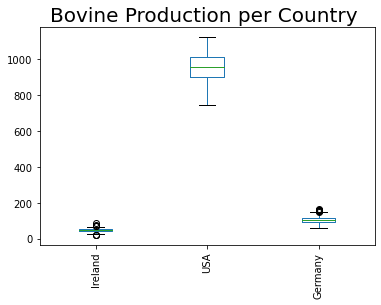

In [59]:
beef.plot(kind='box', rot=90)
plt.title('Bovine Production per Country ', fontsize=20);

## Bovine Plot

In [60]:
beef.iplot(color=[colorIreland, colorUSA, colorGermany],
                title = 'Bovine Meat Production in Ireland, Germany & USA Since 1992')
plt.show()

## Bovine Meat Growth Plot

In [61]:
(beef.iloc[-2] - beef.iloc[0]) / beef.iloc[0]

Ireland    0.5966
USA        0.1173
Germany   -0.3843
dtype: float64

In [62]:
((1 + beef.pct_change()).cumprod() - 1).iplot(color=[colorIreland, colorUSA, colorGermany],
                title = 'Bovine Meat Percentage Growth in Ireland, Germany & USA Since 1992')
plt.show()

## Bovine Meat Variance Plot

In [63]:
fig = px.bar(beef[200:-2].pct_change(), 
             labels={'value': 'Percentage Growth', 'Month':'Date'})
fig.update_layout(title_text='Livestock Slaughterings Growth Ireland', 
                  title_x=0.5, legend_title='Livestock')
#fig.update_traces(marker_color={'Ireland':colorIreland, 'USA':colorUSA, 'Germany':colorGermany})
fig.show()

In [64]:
beef[200:-2].pct_change().iplot(color=[colorIreland, colorUSA, colorGermany],
                       title = 'Bovine Meat Variance from Month to MOnght in Ireland, Germany & USA Since 1992')

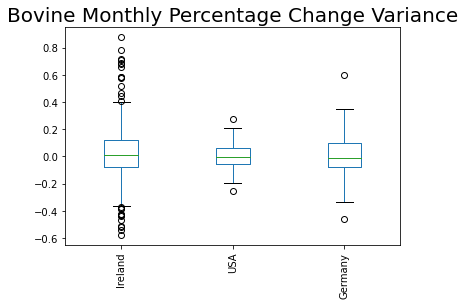

In [65]:
beef.pct_change().plot(kind='box', rot=90)
plt.title("Bovine Monthly Percentage Change Variance", fontsize=20);

# All Population Data

Merge all population data to compare one against the other in terms of growth of population.

In [66]:
allPopulationData = pd.concat([irelandPop, usaPop, germanyPop], axis=1)
allPopulationData

,Ireland Population,USA Population,German Population
Date,,,
1992-01-01,3558430.0000,256514000.0000,80624598.0000
1992-02-01,3559915.9167,256797750.0000,80668911.7500
1992-03-01,3561401.8333,257081500.0000,80713225.5000
1992-04-01,3562887.7500,257365250.0000,80757539.2500
1992-05-01,3564373.6667,257649000.0000,80801853.0000
...,...,...,...
2019-09-01,4974596.0000,329099399.6667,83191337.3333
2019-10-01,4979628.0000,329195580.5000,83203634.2500
2019-11-01,4984660.0000,329291761.3333,83215931.1667


In [67]:
(allPopulationData.iloc[-1] - allPopulationData.iloc[0]) / allPopulationData.iloc[0] * 100

Ireland Population   40.3631
USA Population       28.4468
German Population     3.2446
dtype: float64

In [68]:
allPopulationData[['Ireland Population', 'USA Population', 'German Population']].pct_change().cumsum().iplot(
             color=[colorIreland, colorUSA, colorGermany],
            title = 'Populaiton Growth in Ireland, Germany & USA since 1992')
plt.show()

## Production Per Capita

In [69]:
bovineMeat = allData.copy()
bovineMeat.drop(bovineMeat.tail(len(allData) - len(irelandPop)).index, inplace=True)

bovineMeatData = pd.DataFrame()
bovineMeatData['Ireland Per Capita Bovine Meat Production'] = bovineMeat['Ireland Bovine Meat'].values / irelandPop['Ireland Population'].values * 1000000
bovineMeatData['USA Per Capita Bovine Meat Production'] = bovineMeat['USA Bovine Meat'].values / usaPop['USA Population'].values * 1000000
bovineMeatData['Germany Per Capita Bovine Meat Production'] = bovineMeat['Germany Bovine Meat'].values / germanyPop['German Population'].values * 1000000

In [70]:
(bovineMeatData.iloc[-1] - bovineMeatData.iloc[0]) / bovineMeatData.iloc[0] * 100

Ireland Per Capita Bovine Meat Production    14.2140
USA Per Capita Bovine Meat Production        -8.1659
Germany Per Capita Bovine Meat Production   -39.1485
dtype: float64

In [71]:
((1 + bovineMeatData.pct_change()).cumprod() - 1).iplot(color=[colorIreland, colorUSA, colorGermany], 
                        title = 'Bovine Meat Percentage Growth Per Capita in Ireland, Germany & USA Since 1992')

plt.show()

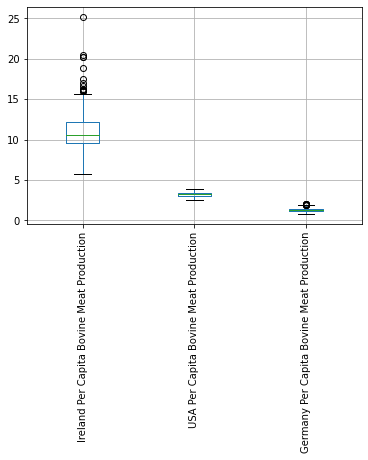

In [72]:
bovineMeatData.boxplot(rot=90);

# GDP Growth

In [73]:
allEco = pd.concat([irelandGDP, germanyGDP, usaGDP], axis=1)
allEco

,Ireland GDP,Ireland GDP Per Capita,Germany GDP,Germany GDP Per Capita,USA GDP,USA GDP Per Capita
Year,,,,,,
1992-01-01,76486482000.0000,11727.6453,2261460000000.0000,21110.9270,10139200000000.0000,25418.9908
1992-02-01,76658105500.0000,11800.6422,2259619166666.6665,21149.5396,10162450000000.0000,25499.6827
1992-03-01,76829729000.0000,11873.6390,2257778333333.3335,21188.1523,10185700000000.0000,25580.3746
1992-04-01,77001352500.0000,11946.6358,2255937500000.0000,21226.7649,10208950000000.0000,25661.0665
1992-05-01,77172976000.0000,12019.6326,2254096666666.6665,21265.3776,10232200000000.0000,25741.7584
...,...,...,...,...,...,...
2019-09-01,347254666666.6667,73943.3529,3146116666666.6665,40929.9411,19521166666666.6680,63897.5237
2019-10-01,348888500000.0000,74154.5104,3133760000000.0000,40821.0871,19464500000000.0000,63724.7731
2019-11-01,350522333333.3333,74365.6678,3121403333333.3335,40712.2332,19407833333333.3320,63552.0224


In [74]:
(allEco.iloc[-1] - allEco.iloc[0]) / allEco.iloc[0] * 100

Ireland GDP              362.5523
Ireland GDP Per Capita   537.7067
Germany GDP               36.9332
Germany GDP Per Capita    91.8178
USA GDP                   90.2961
USA GDP Per Capita       148.6587
dtype: float64

In [75]:
((1 + allEco.filter(items=allEco.columns[~allEco.columns.str.contains(
    "Capita",regex=True)]).pct_change()).cumprod() - 1).dropna().iplot(
    title = 'GDP Growth Ireland, Germany & USA Since 1992',
    color=[colorIreland, colorGermany, colorUSA])

plt.show()

In [76]:
((1 + allEco.filter(items=allEco.columns[allEco.columns.str.contains(
    "Capita",regex=True)]).pct_change()).cumprod() - 1).dropna().iplot(
    title = 'GDP Per Capita Growth Ireland, Germany & USA Since 1992',
    color=[colorIreland, colorGermany, colorUSA])

plt.show()

# Production vs GDP Per Capita

## Ireland

In [77]:
irelandProGDP = pd.concat([irelandGDP['Ireland GDP Per Capita'], irelandData['Ireland Bovine Meat']], axis=1)
irelandProGDP.dropna(inplace=True)
(irelandProGDP.iloc[-1] - irelandProGDP.iloc[0]) / irelandProGDP.iloc[0] * 100

Ireland GDP Per Capita   537.7067
Ireland Bovine Meat       60.3143
dtype: float64

In [78]:
((1 + irelandProGDP.pct_change()).cumprod() - 1).iplot(kind='line', yTitle='Percentage growth', 
                                                      xTitle='Date',  
                    title='Ireland Bovine Meat Production per Capita Since 1992',
                                                    color=[colorIreland, 'red'])
plt.show()

## Germany

In [79]:
germanyProGDP = pd.concat([germanyGDP['Germany GDP Per Capita'], germanData['Germany Bovine Meat']], axis=1)
germanyProGDP.dropna(inplace=True)
(germanyProGDP.iloc[-1] - germanyProGDP.iloc[0]) / germanyProGDP.iloc[0] * 100

Germany GDP Per Capita    91.8178
Germany Bovine Meat      -37.1741
dtype: float64

In [80]:
((1 + germanyProGDP.pct_change()).cumprod() - 1).iplot(kind='line', yTitle='Percentage growth', 
                                                      xTitle='Date',  
                                                       title='Germany Bovine Meat Production per Capita Since 1992',
                                                      color=[colorGermany, 'red'])

## USA

In [81]:
usaProGDP = pd.concat([usaGDP['USA GDP Per Capita'], usaData['USA Bovine Meat']], axis=1)
usaProGDP.dropna(inplace=True)
(usaProGDP.iloc[-1] - usaProGDP.iloc[0]) / usaProGDP.iloc[0] * 100

USA GDP Per Capita   148.6587
USA Bovine Meat       17.9580
dtype: float64

In [82]:
((1 + usaProGDP.pct_change()).cumprod() - 1).iplot(kind='line', yTitle='Percentage growth', 
                                                      xTitle='Date',  
                                    title='USA Bovine Meat Production per Capita Since 1992',
                                                      color=[colorUSA, 'red'])

# Trade

In [83]:
allTrade = pd.concat([irelandTrade, germanyTrade, usaTrade], axis=1)
allTrade

Element,Export Quantity,Import Quantity,Ireland Surplus,Export Quantity,Import Quantity,Germany Surplus,Export Quantity,Import Quantity,USA Surplus
Year,,,,,,,,,
1992-01-01,71485.0000,6630.0000,64855.0000,499140.0000,139669.0000,359471.0000,82105.0000,63513.0000,18592.0000
1992-02-01,72090.0833,6511.4167,65578.6667,489988.5833,138668.1667,351320.4167,79726.9167,64245.9167,15481.0000
1992-03-01,72695.1667,6392.8333,66302.3333,480837.1667,137667.3333,343169.8333,77348.8333,64978.8333,12370.0000
1992-04-01,73300.2500,6274.2500,67026.0000,471685.7500,136666.5000,335019.2500,74970.7500,65711.7500,9259.0000
1992-05-01,73905.3333,6155.6667,67749.6667,462534.3333,135665.6667,326868.6667,72592.6667,66444.6667,6148.0000
...,...,...,...,...,...,...,...,...,...
2019-09-01,35891.0000,6803.6667,29087.3333,140333.6667,124401.0000,15932.6667,124205.6667,122391.0000,1814.6667
2019-10-01,35510.7500,6883.5000,28627.2500,139381.2500,124207.7500,15173.5000,123427.5000,123194.2500,233.2500
2019-11-01,35130.5000,6963.3333,28167.1667,138428.8333,124014.5000,14414.3333,122649.3333,123997.5000,-1348.1667


## Trade Surplus Plot

In [84]:
allTrade[['Ireland Surplus', 'Germany Surplus', 'USA Surplus']].iplot(kind='line', yTitle='Percentage growth', 
            xTitle='Date',  title='Trade Bovine Meat Surplus in Ireland, Germany and USA Since 1992',
            color=[colorIreland, colorGermany, colorUSA])

plt.show()

## Trade Surplus Growth Plot

In [85]:
((1 + allTrade[['Ireland Surplus', 'Germany Surplus', 'USA Surplus']].pct_change()).cumprod() - 1).iplot(kind='line', yTitle='Percentage growth', 
            xTitle='Date',  title='Trade Bovine Meat Surplus Growth Change in Ireland, Germany and USA Since 1992',
            color=[colorIreland, colorGermany, colorUSA])

plt.show()

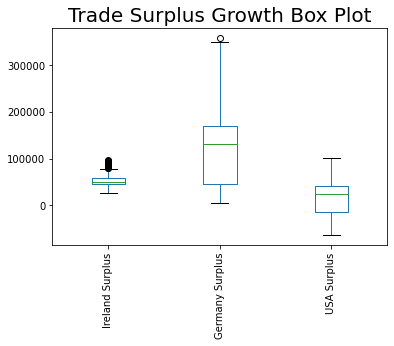

In [86]:
allTrade[['Ireland Surplus', 'Germany Surplus', 'USA Surplus']].plot(kind='box', rot=90)
plt.title('Trade Surplus Growth Box Plot', fontsize=20);

# Bovine Yield Growth Plot

In [87]:
beefProduction = pd.concat([irelandYield, germanyYield, usaYield], axis=1)

((1 + beefProduction.pct_change()).cumprod() - 1).iplot(kind='line', yTitle='Percentage growth', 
            xTitle='Date',  title='Bovine Meat Carcass Yield in Ireland, Germany and USA Since 1992',
            color=[colorIreland, colorGermany, colorUSA])

plt.show()

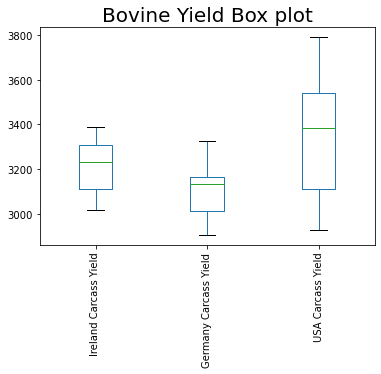

In [88]:
beefProduction.plot(kind='box', rot=90)
plt.title('Bovine Yield Box plot', fontsize=20);

# Prepare Data For Machine Learning Model

Merge individual country datasets into one dataset per country.  This will be preprocssing of the data just before feature engineering, imputing and scaling. 

### Ireland

In [89]:
irelandAllData = pd.concat([irelandGDP, irelandYield, irelandPop, 
                            irelandTrade, prices, irelandData], axis=1).dropna()
irelandAllData

,Ireland GDP,Ireland GDP Per Capita,Ireland Carcass Yield,Ireland Population,Export Quantity,Import Quantity,Ireland Surplus,Price,Ireland Bovine Meat,Ireland Pig Meat,Ireland Lamb Meat
1992-01-01,76486482000.0000,11727.6453,3309.0000,3558430.0000,71485.0000,6630.0000,64855.0000,2.5150,35.0000,17.9000,6.5000
1992-02-01,76658105500.0000,11800.6422,3308.5000,3559915.9167,72090.0833,6511.4167,65578.6667,2.4650,31.9000,15.0000,5.3000
1992-03-01,76829729000.0000,11873.6390,3308.0000,3561401.8333,72695.1667,6392.8333,66302.3333,2.4151,46.7000,16.5000,4.7000
1992-04-01,77001352500.0000,11946.6358,3307.5000,3562887.7500,73300.2500,6274.2500,67026.0000,2.3651,40.0000,16.0000,5.9000
1992-05-01,77172976000.0000,12019.6326,3307.0000,3564373.6667,73905.3333,6155.6667,67749.6667,2.3803,33.8000,15.9000,7.9000
...,...,...,...,...,...,...,...,...,...,...,...
2019-09-01,347254666666.6667,73943.3529,3359.3333,4974596.0000,35891.0000,6803.6667,29087.3333,5.0410,32.9700,24.4600,5.2800
2019-10-01,348888500000.0000,74154.5104,3361.0000,4979628.0000,35510.7500,6883.5000,28627.2500,5.3036,61.8200,26.2000,6.6900
2019-11-01,350522333333.3333,74365.6678,3362.6667,4984660.0000,35130.5000,6963.3333,28167.1667,5.0343,59.8900,26.2900,6.1200
2019-12-01,352156166666.6667,74576.8253,3364.3333,4989692.0000,34750.2500,7043.1667,27707.0833,4.7650,48.2500,23.6800,5.8100


### Germany

In [90]:
germanyAllData = pd.concat([germanyGDP, germanyYield, germanyPop, 
                            germanyTrade, prices, germanData], axis=1).dropna()
germanyAllData

,Germany GDP,Germany GDP Per Capita,Germany Carcass Yield,German Population,Export Quantity,Import Quantity,Germany Surplus,Price,Germany Bovine Meat,Germany Pig Meat,Germany Lamb Meat
1992-01-01,2261460000000.0000,21110.9270,2905.0000,80624598.0000,499140.0000,139669.0000,359471.0000,2.5150,159.1700,323.2400,2.9100
1992-02-01,2259619166666.6665,21149.5396,2908.5833,80668911.7500,489988.5833,138668.1667,351320.4167,2.4650,140.1100,285.4000,2.5200
1992-03-01,2257778333333.3335,21188.1523,2912.1667,80713225.5000,480837.1667,137667.3333,343169.8333,2.4151,164.5400,316.9800,3.1600
1992-04-01,2255937500000.0000,21226.7649,2915.7500,80757539.2500,471685.7500,136666.5000,335019.2500,2.3651,155.6100,297.4600,3.6500
1992-05-01,2254096666666.6665,21265.3776,2919.3333,80801853.0000,462534.3333,135665.6667,326868.6667,2.3803,144.8200,300.1500,2.7000
...,...,...,...,...,...,...,...,...,...,...,...
2019-09-01,3146116666666.6665,40929.9411,3301.0000,83191337.3333,140333.6667,124401.0000,15932.6667,5.0410,93.0000,440.0000,2.0000
2019-10-01,3133760000000.0000,40821.0871,3307.0000,83203634.2500,139381.2500,124207.7500,15173.5000,5.3036,103.0000,468.0000,2.0000
2019-11-01,3121403333333.3335,40712.2332,3313.0000,83215931.1667,138428.8333,124014.5000,14414.3333,5.0343,111.0000,460.0000,2.0000
2019-12-01,3109046666666.6665,40603.3793,3319.0000,83228228.0833,137476.4167,123821.2500,13655.1667,4.7650,89.0000,414.0000,2.0000


### USA

In [91]:
usaAllData = pd.concat([usaGDP, usaYield, usaPop, 
                            usaTrade, prices, usaData], axis=1).dropna()
usaAllData

,USA GDP,USA GDP Per Capita,USA Carcass Yield,USA Population,Export Quantity,Import Quantity,USA Surplus,Price,USA Bovine Meat,USA Pig Meat,USA Lamb Meat
1992-01-01,10139200000000.0000,25418.9908,3014.0000,256514000.0000,82105.0000,63513.0000,18592.0000,2.5150,906.2776,676.3062,13.6078
1992-02-01,10162450000000.0000,25499.6827,3014.0000,256797750.0000,79726.9167,64245.9167,15481.0000,2.4650,757.9529,589.6701,12.2470
1992-03-01,10185700000000.0000,25580.3746,3014.0000,257081500.0000,77348.8333,64978.8333,12370.0000,2.4151,821.9094,651.3586,14.5150
1992-04-01,10208950000000.0000,25661.0665,3014.0000,257365250.0000,74970.7500,65711.7500,9259.0000,2.3651,794.2402,628.2254,14.5150
1992-05-01,10232200000000.0000,25741.7584,3014.0000,257649000.0000,72592.6667,66444.6667,6148.0000,2.3803,846.8570,571.9800,10.8862
...,...,...,...,...,...,...,...,...,...,...,...
2019-09-01,19521166666666.6680,63897.5237,3670.6667,329099399.6667,124205.6667,122391.0000,1814.6667,5.0410,980.0317,1009.4245,4.3998
2019-10-01,19464500000000.0000,63724.7731,3679.0000,329195580.5000,123427.5000,123194.2500,233.2500,5.3036,1090.3907,1176.3465,5.2163
2019-11-01,19407833333333.3320,63552.0224,3687.3333,329291761.3333,122649.3333,123997.5000,-1348.1667,5.0343,1030.5165,1097.2399,4.6266
2019-12-01,19351166666666.6680,63379.2717,3695.6667,329387942.1667,121871.1667,124800.7500,-2929.5833,4.7650,1015.6840,1103.4995,4.9895


# Descriptive Statistics

In this section statistics will be done on all the data for each country.  Additionally the datasets will be checked for normal distributions and compared with the proper statistical test.  This will allow for acceptance or rejection of null hypothesis.


https://www.statology.org/python-guides/
https://pingouin-stats.org/api.html


In [92]:
import pingouin as pg

## Ireland

In [93]:
irelandAllData.describe()

,Ireland GDP,Ireland GDP Per Capita,Ireland Carcass Yield,Ireland Population,Export Quantity,Import Quantity,Ireland Surplus,Price,Ireland Bovine Meat,Ireland Pig Meat,Ireland Lamb Meat
count,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000
mean,183252997913.9466,37539.1028,3214.9184,4230366.2819,58341.3694,6073.7641,52267.6053,2.9396,46.3696,19.5099,5.8798
std,71261498532.1322,16453.9733,112.2077,464416.0490,11742.4748,2676.7195,12830.7570,1.0203,8.8794,3.0352,1.7486
min,76486482000.0000,11727.6453,3018.0000,3558430.0000,34370.0000,97.0000,27247.0000,1.6622,20.8000,14.1000,2.0000
25%,130485000000.0000,24712.6007,3112.3333,3754786.0000,50600.1667,4485.0000,44733.0000,2.0158,41.0200,17.2000,4.6000
50%,187426333333.3333,37709.4495,3230.0000,4273591.0000,56908.9167,6093.0000,50424.0000,2.6004,46.2900,18.7000,5.6000
75%,202103000000.0000,43651.9599,3309.2500,4623816.0000,63288.0000,7778.2500,58111.0000,3.9977,51.5000,21.6200,6.9000
max,353790000000.0000,74787.9827,3388.0000,4994724.0000,98538.0000,13568.0000,96894.0000,5.6440,90.0000,29.7000,10.3000


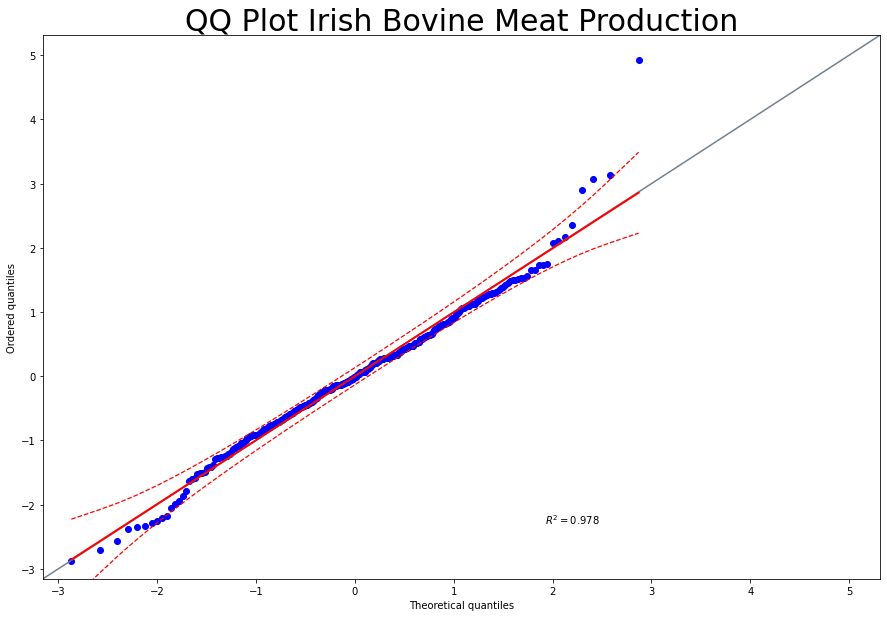

<Figure size 432x288 with 0 Axes>

In [94]:
#Normality plot. Our variable is "charges"
ax = pg.qqplot(irelandAllData['Ireland Bovine Meat'], figsize=(15,10))
plt.title("QQ Plot Irish Bovine Meat Production", fontsize=30)
plt.figure();

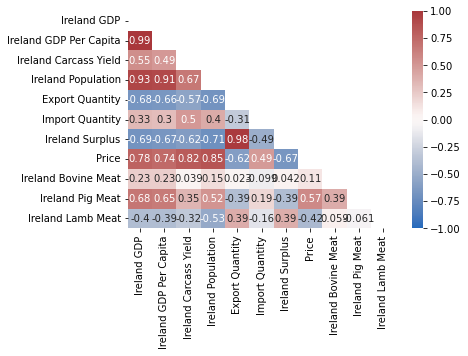

In [95]:
mask = np.triu(np.ones_like(irelandAllData.corr(), dtype=bool))
sns.heatmap(irelandAllData.corr(), annot=True, vmax=1, vmin=-1, center=0, mask = mask, cmap='vlag')
plt.show();

In [96]:
ProfileReport(irelandAllData)

Summarize dataset:   0%|          | 0/26 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

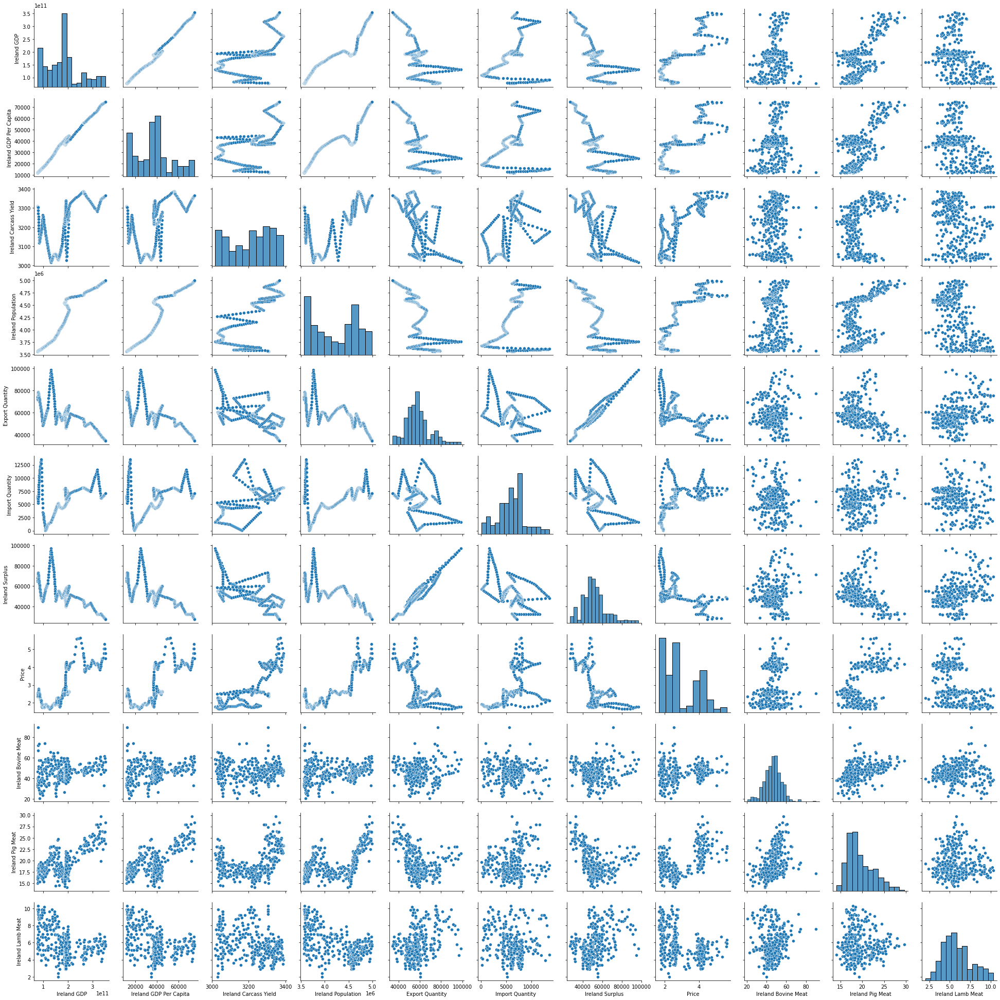

In [97]:
sns.pairplot(irelandAllData)

## Germany

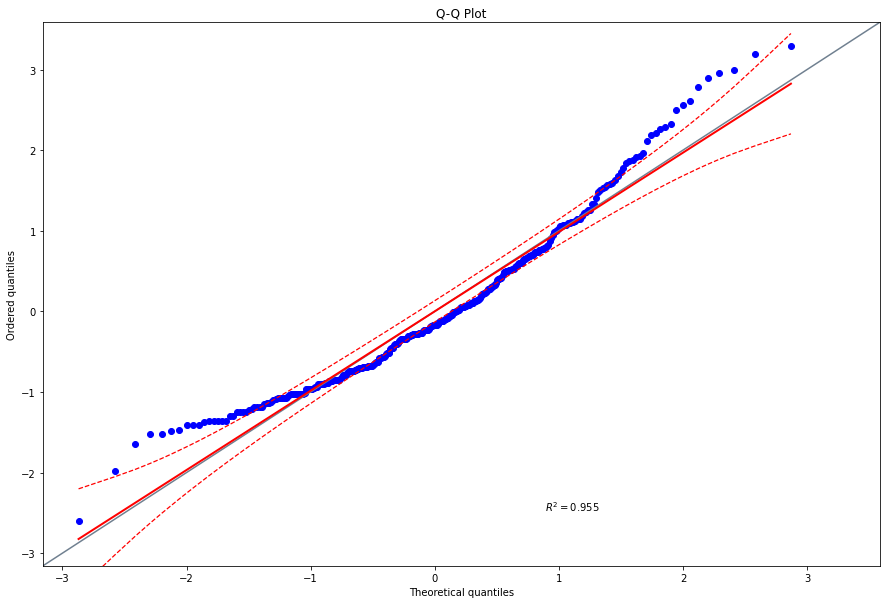

<Figure size 432x288 with 0 Axes>

In [98]:
#Normality plot. Our variable is "charges"
ax = pg.qqplot(germanyAllData['Germany Bovine Meat'], figsize=(15,10))
plt.figure();

In [99]:
germanyAllData.describe()

,Germany GDP,Germany GDP Per Capita,Germany Carcass Yield,German Population,Export Quantity,Import Quantity,Germany Surplus,Price,Germany Bovine Meat,Germany Pig Meat,Germany Lamb Meat
count,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000
mean,2714755771513.3530,30109.7528,3096.8754,81940129.0312,214407.0623,92287.6988,122119.3635,2.9396,106.0945,386.0739,2.9109
std,291356466367.3461,6046.2145,100.5342,723563.6261,63496.3550,43315.3767,73854.0014,1.0203,17.7787,65.7352,1.3047
min,2239370000000.0000,21110.9270,2905.0000,80274983.0000,136524.0000,23437.0000,5268.0000,1.6622,59.9300,265.0700,1.0000
25%,2483280000000.0000,25084.9440,3012.0000,81526605.5000,176936.0000,47694.3333,46622.3333,2.0158,93.0000,324.0400,2.0000
50%,2691383333333.3335,28953.4202,3135.0000,82075465.3333,201530.6667,94874.0833,131788.5000,2.6004,103.0000,383.4100,2.6900
75%,2917240000000.0000,34860.5482,3166.4167,82453926.8333,232350.0000,136919.0000,169628.8333,3.9977,116.4300,446.0000,3.5900
max,3244970000000.0000,41800.7725,3325.0000,83240525.0000,499140.0000,153050.0000,359471.0000,5.6440,164.5400,504.0000,7.7300


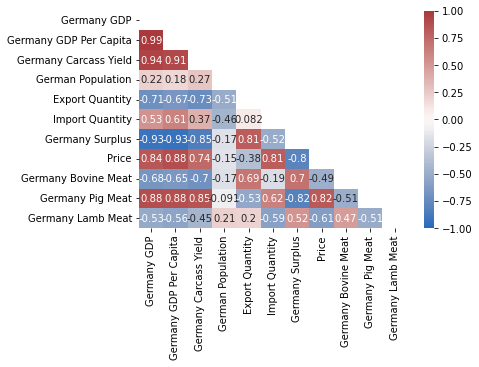

In [100]:
mask = np.triu(np.ones_like(germanyAllData.corr(), dtype=bool))
sns.heatmap(germanyAllData.corr(), annot=True, vmax=1, vmin=-1, center=0, mask = mask, cmap='vlag')
plt.show();

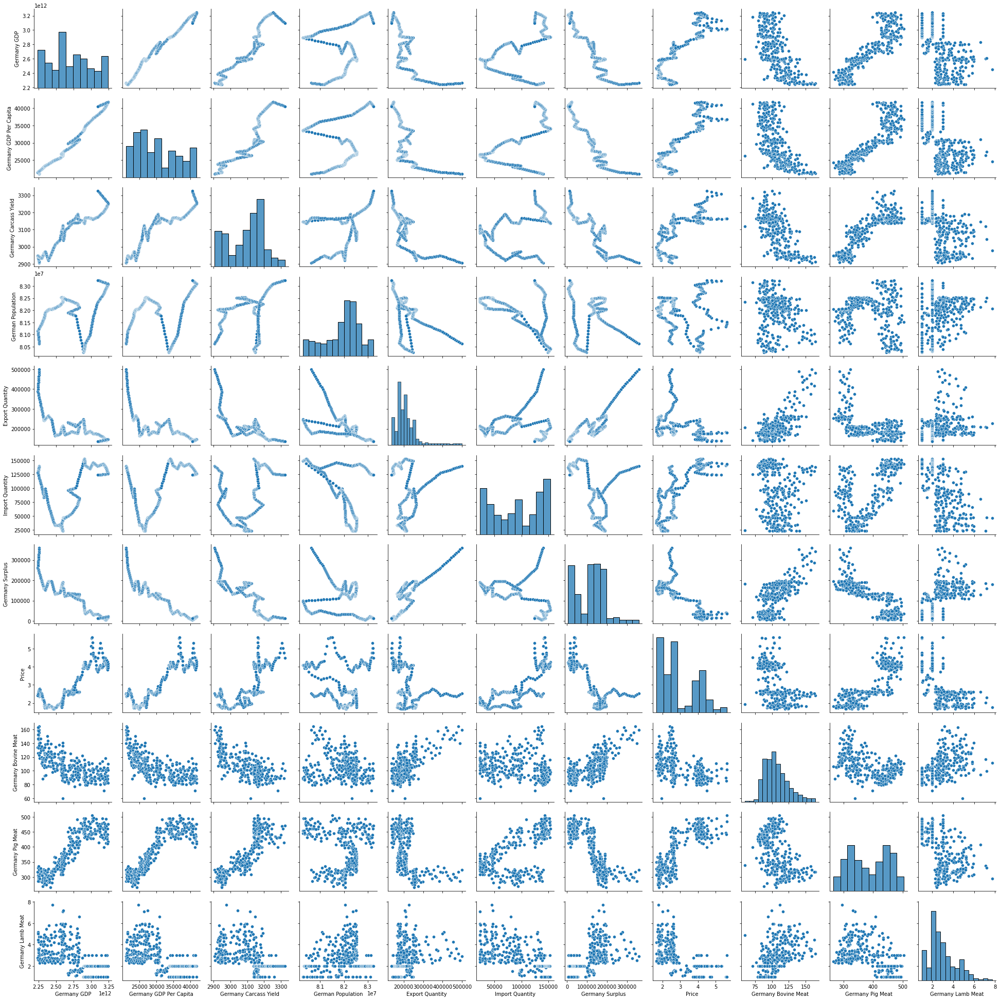

In [101]:
sns.pairplot(germanyAllData)

In [102]:
ProfileReport(germanyAllData)

Summarize dataset:   0%|          | 0/26 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## USA

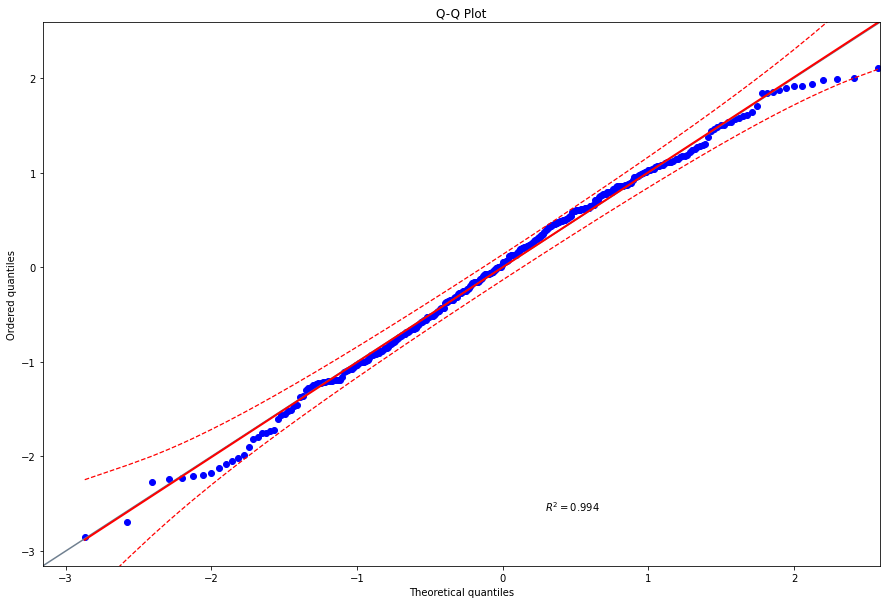

<Figure size 432x288 with 0 Axes>

In [103]:
#Normality plot. Our variable is "charges"
ax = pg.qqplot(usaAllData['USA Bovine Meat'], figsize=(15,10))
plt.figure();

In [104]:
usaAllData.describe()

,USA GDP,USA GDP Per Capita,USA Carcass Yield,USA Population,Export Quantity,Import Quantity,USA Surplus,Price,USA Bovine Meat,USA Pig Meat,USA Lamb Meat
count,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000,337.0000
mean,15289187685459.9414,44424.6492,3351.5579,296997587.3220,90485.1128,75780.3694,14704.7433,2.9396,953.3250,794.6790,7.4385
std,2784128131668.9365,11526.1355,245.1709,21612764.1152,37553.1375,33671.1589,36284.5119,1.0203,72.5573,128.0148,2.3766
min,10139200000000.0000,25418.9908,2929.0000,256514000.0000,5070.0000,13883.0000,-64484.0000,1.6622,746.6130,537.0534,4.3998
25%,13193600000000.0000,34513.5615,3112.2500,279040000.0000,68455.4167,49801.0000,-14452.3333,2.0158,901.7870,690.8212,5.5338
50%,15946616666666.6660,46298.7314,3383.0000,298379912.0000,98785.8333,76032.5000,25188.6667,2.6004,957.3521,786.5292,6.6678
75%,17258200000000.0000,53106.5368,3539.0000,316059947.0000,121657.5000,101700.2500,41027.5000,3.9977,1007.9276,889.2678,8.6183
max,19974500000000.0000,65279.5290,3791.0000,329484123.0000,137348.0000,142129.0000,102163.0000,5.6440,1122.1875,1176.3465,15.4221


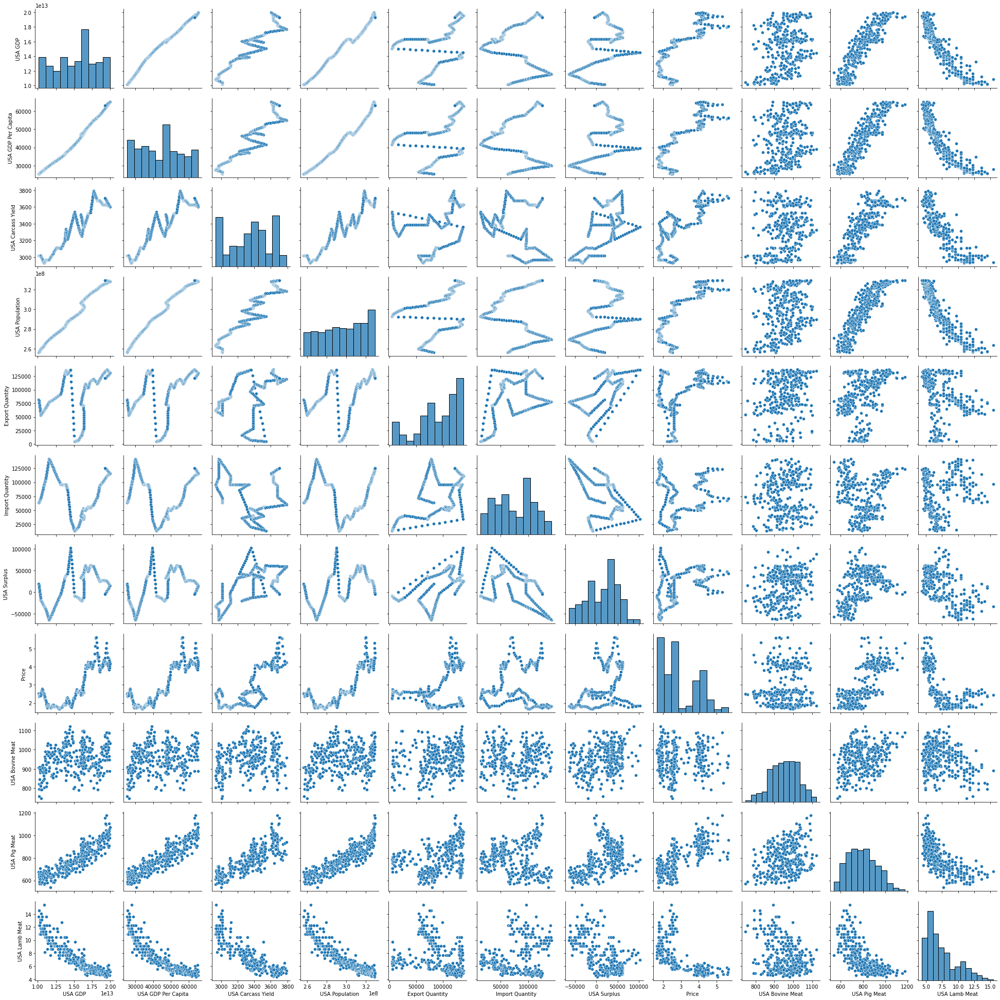

In [105]:
sns.pairplot(usaAllData)

In [106]:
ProfileReport(usaAllData)

Summarize dataset:   0%|          | 0/26 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

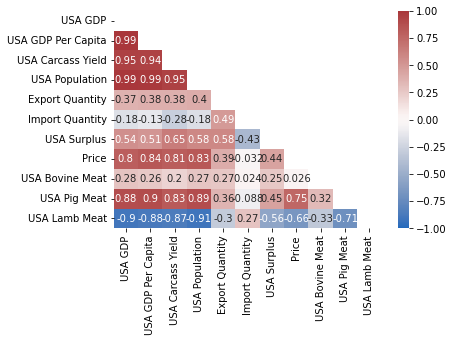

In [107]:
# Only plot the highly correlated data or half the correlation matrix
#https://datagy.io/python-correlation-matrix/
mask = np.triu(np.ones_like(usaAllData.corr(), dtype=bool))
sns.heatmap(usaAllData.corr(), annot=True, vmax=1, vmin=-1, center=0, mask = mask, cmap='vlag')
plt.show();

## All Data

In [108]:
allData.describe()

,Ireland Bovine Meat,Ireland Pig Meat,Ireland Lamb Meat,USA Bovine Meat,USA Pig Meat,USA Lamb Meat,Germany Bovine Meat,Germany Pig Meat,Germany Lamb Meat
count,348.0000,348.0000,348.0000,348.0000,348.0000,348.0000,348.0000,348.0000,348.0000
mean,46.5627,19.7318,5.8681,954.9707,802.9415,7.3496,105.5858,387.2095,2.8878
std,8.8600,3.2418,1.7268,73.9692,135.0644,2.3908,17.7737,65.0466,1.2920
min,20.8000,14.1000,2.0000,746.6130,537.0534,4.1730,59.9300,265.0700,1.0000
25%,41.1450,17.2775,4.6625,903.1137,696.2643,5.4318,92.6500,325.0750,2.0000
50%,46.5900,18.8000,5.5750,957.6469,791.0651,6.5998,102.7950,396.2750,2.6650
75%,51.9100,21.8100,6.9000,1010.6378,899.6438,8.6183,115.9625,445.2500,3.5600
max,90.0000,29.7000,10.3000,1122.1875,1176.3465,15.4221,164.5400,504.0000,7.7300


## Ireland and Germany Bland Altman Plot

In this plot Ireland and Germany's mean and testing within 2 standard deviations. This is an additional statistical measurement to show what correlation or regression might not show.  This was an interesting test and easy to interpret.  Ireland and Germany are showing good agreement

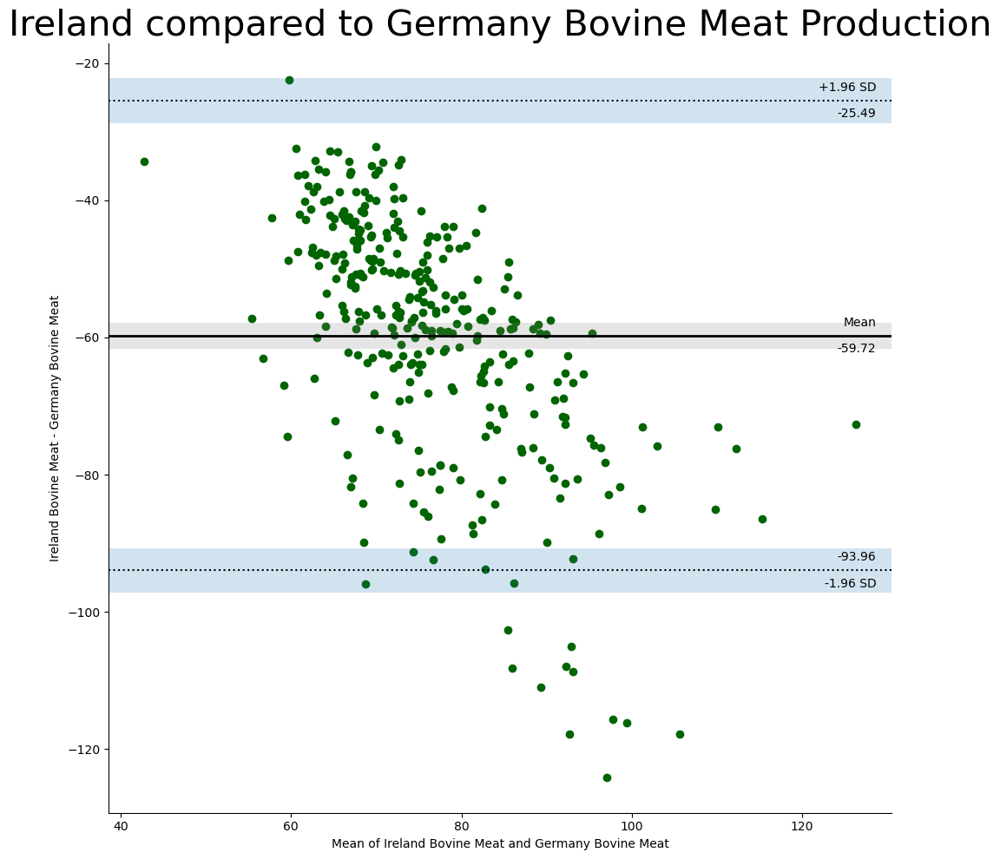

In [109]:
#https://pingouin-stats.org/generated/pingouin.plot_blandaltman.html#pingouin.plot_blandaltman
ax = pg.plot_blandaltman(irelandAllData['Ireland Bovine Meat'], germanyAllData['Germany Bovine Meat'], 
                         figsize=(10,10), scatter_kws={'color': colorIreland})
plt.title('Ireland compared to Germany Bovine Meat Production', fontsize=30)
plt.tight_layout();

## Ireland and USA Bland Altman Plot

In this plot Ireland and USA's mean and testing within 2 standard deviations. This is an additional statistical measurement to show what correlation or regression might not show.  This was an interesting test and easy to interpret.  Ireland and USA are showing a lack of agreement

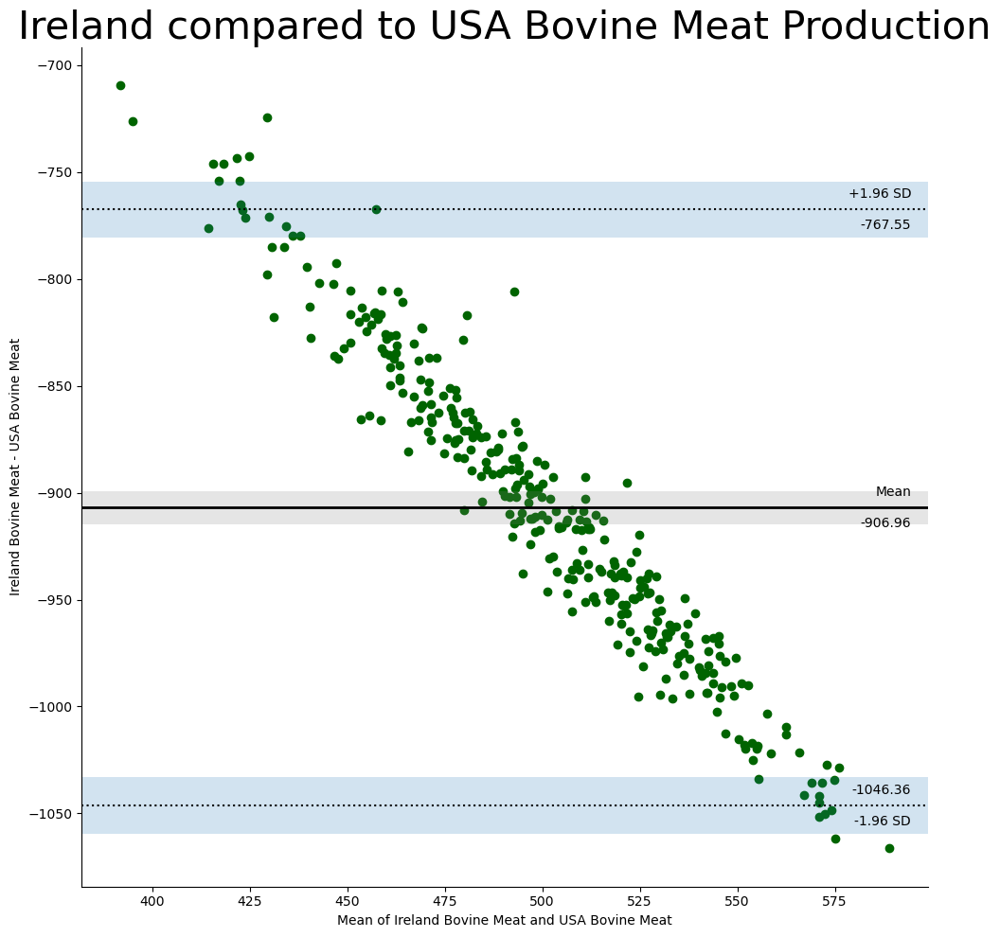

In [110]:
ax = pg.plot_blandaltman(irelandAllData['Ireland Bovine Meat'], 
                         usaAllData['USA Bovine Meat'], figsize=(10,10),
                        scatter_kws={'color': colorIreland})
plt.title('Ireland compared to USA Bovine Meat Production', fontsize=30)
plt.tight_layout();

## Plot Shift Ireland Vs Germany

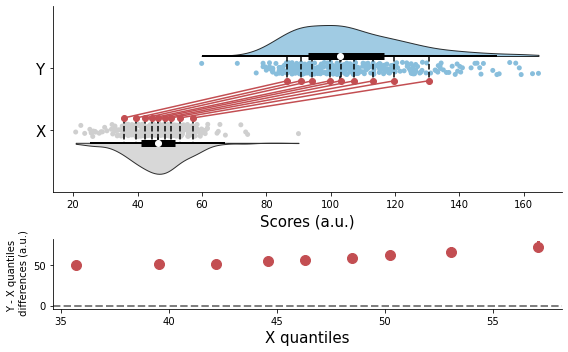

In [111]:
# Plot shift
#https://pingouin-stats.org/generated/pingouin.plot_shift.html
#pingouin.plot_shift
# Ireland is X and Germany is Y
fig = pg.plot_shift(irelandAllData['Ireland Bovine Meat'], germanyAllData['Germany Bovine Meat'])

## Plot Shift Ireland Vs USA

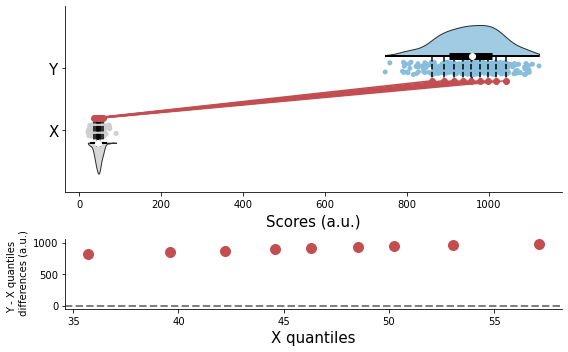

In [112]:
# Ireland is X and USA is Y
fig = pg.plot_shift(irelandAllData['Ireland Bovine Meat'], usaAllData['USA Bovine Meat'])

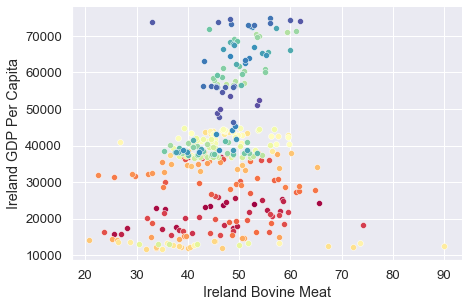

In [113]:
sns.set(style='darkgrid', font_scale=1.2)

g = pg.plot_rm_corr(data=irelandAllData, x='Ireland Bovine Meat', y='Ireland GDP Per Capita',
                    subject='Price', legend=False,
                    kwargs_facetgrid=dict(height=4.5, aspect=1.5,
                                          palette='Spectral'))

# Normal Distribution and Null Hypothesis Tests / Inferential Statistics

## Irleland and Germany

In [114]:
fn.Stats.distribution(beef[['Ireland','Germany']])

Ireland not normal distribution, pvalue = 0.000218

Germany not normal distribution, pvalue = 0.000000

Reject Null Hypothesis P-Value 0.0000


MannwhitneyuResult(statistic=83.5, pvalue=4.651183231644249e-115)

## Ireland and USA

In [115]:
fn.Stats.distribution(beef[['Ireland','USA']])

Ireland not normal distribution, pvalue = 0.000218

USA not normal distribution, pvalue = 0.043295

Reject Null Hypothesis P-Value 0.0000


MannwhitneyuResult(statistic=0.0, pvalue=2.2700291563892367e-115)

## All Countries Statistical Inference

In [116]:
fn.Stats.distribution(beef)

Ireland not normal distribution, pvalue = 0.000218

USA not normal distribution, pvalue = 0.043295

Germany not normal distribution, pvalue = 0.000000

Accept Null Hypothesis P-Value 0.3679


KruskalResult(statistic=2.0, pvalue=0.36787944117144245)

## Ireland All Stats

In [117]:
fn.Stats.distribution(irelandAllData)

Ireland GDP not normal distribution, pvalue = 0.000000

Ireland GDP Per Capita not normal distribution, pvalue = 0.000000

Ireland Carcass Yield not normal distribution, pvalue = 0.000000

Ireland Population not normal distribution, pvalue = 0.000000

Export Quantity not normal distribution, pvalue = 0.000000

Import Quantity not normal distribution, pvalue = 0.000061

Ireland Surplus not normal distribution, pvalue = 0.000000

Price not normal distribution, pvalue = 0.000000

Ireland Bovine Meat not normal distribution, pvalue = 0.000159

Ireland Pig Meat not normal distribution, pvalue = 0.000000

Ireland Lamb Meat not normal distribution, pvalue = 0.000001

Accept Null Hypothesis P-Value 0.4405


KruskalResult(statistic=10.0, pvalue=0.44049328506521257)

## Germany All Stats

In [118]:
fn.Stats.distribution(germanyAllData)

Germany GDP not normal distribution, pvalue = 0.000000

Germany GDP Per Capita not normal distribution, pvalue = 0.000000

Germany Carcass Yield not normal distribution, pvalue = 0.000000

German Population not normal distribution, pvalue = 0.000000

Export Quantity not normal distribution, pvalue = 0.000000

Import Quantity not normal distribution, pvalue = 0.000000

Germany Surplus not normal distribution, pvalue = 0.000000

Price not normal distribution, pvalue = 0.000000

Germany Bovine Meat not normal distribution, pvalue = 0.000000

Germany Pig Meat not normal distribution, pvalue = 0.000000

Germany Lamb Meat not normal distribution, pvalue = 0.000000

Accept Null Hypothesis P-Value 0.4405


KruskalResult(statistic=10.0, pvalue=0.44049328506521257)

## USA All Stats

In [119]:
fn.Stats.distribution(usaAllData)

USA GDP not normal distribution, pvalue = 0.000000

USA GDP Per Capita not normal distribution, pvalue = 0.000000

USA Carcass Yield not normal distribution, pvalue = 0.000000

USA Population not normal distribution, pvalue = 0.000000

Export Quantity not normal distribution, pvalue = 0.000000

Import Quantity not normal distribution, pvalue = 0.000000

USA Surplus not normal distribution, pvalue = 0.000001

Price not normal distribution, pvalue = 0.000000

USA Bovine Meat normal distribution, pvalue = 0.087712

USA Pig Meat not normal distribution, pvalue = 0.000172

USA Lamb Meat not normal distribution, pvalue = 0.000000

Accept Null Hypothesis P-Value 0.4405


KruskalResult(statistic=10.0, pvalue=0.44049328506521257)

# Probability Distribution

## Ireand Probability Distribution

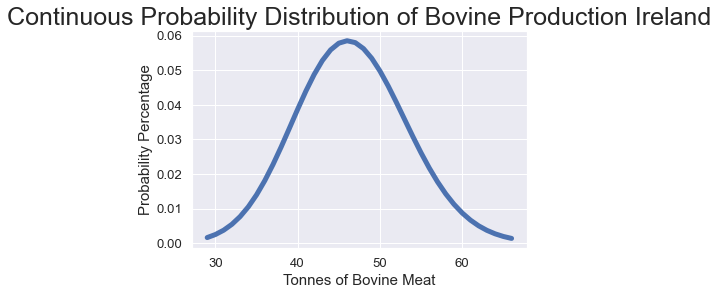

In [120]:
from scipy.stats import poisson, norm
# https://www.alphacodingskills.com/scipy/scipy-poisson-distribution.php
mu = beef['Ireland'].mean()
x = np.arange(0, int(mu+mu), 1)
y = poisson.pmf(x, mu, 0)

plt.plot(x[y>0.001], y[y>0.001],lw=5) 
plt.title('Continuous Probability Distribution of Bovine Production Ireland', fontsize=25)
plt.ylabel('Probability Percentage', fontsize=15)
plt.xlabel('Tonnes of Bovine Meat', fontsize=15)
plt.show()

In [121]:
# Verify sum equal 1
sum(y)

0.9999999986346457

## Germany Probability Distribution

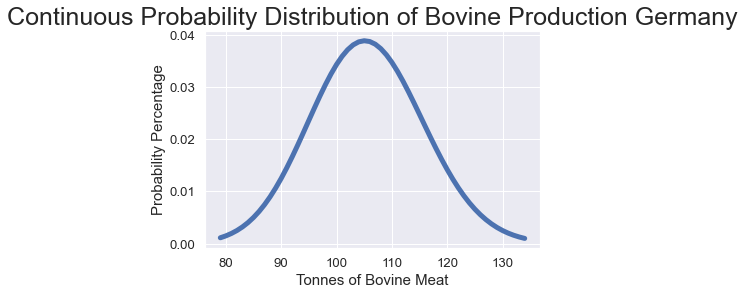

In [122]:
# https://www.alphacodingskills.com/scipy/scipy-poisson-distribution.php
mu = beef['Germany'].mean()
x = np.arange(0, int(mu+mu), 1)
y = poisson.pmf(x, mu, 0)

plt.plot(x[y>0.001], y[y>0.001],lw=5) 
plt.title('Continuous Probability Distribution of Bovine Production Germany', fontsize=25)
plt.ylabel('Probability Percentage', fontsize=15)
plt.xlabel('Tonnes of Bovine Meat', fontsize=15)
plt.show()

## USA Probability Distribution

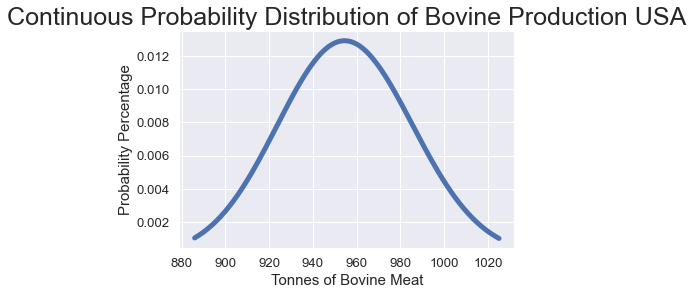

In [123]:
# https://www.alphacodingskills.com/scipy/scipy-poisson-distribution.php
mu = beef['USA'].mean()
x = np.arange(0, int(mu+mu), 1)
y = poisson.pmf(x, mu, 0)

plt.plot(x[y>0.001], y[y>0.001],lw=5) 
plt.title('Continuous Probability Distribution of Bovine Production USA', fontsize=25)
plt.ylabel('Probability Percentage', fontsize=15)
plt.xlabel('Tonnes of Bovine Meat', fontsize=15)
plt.show()

## Logrithmic Plot Ireland and Germany

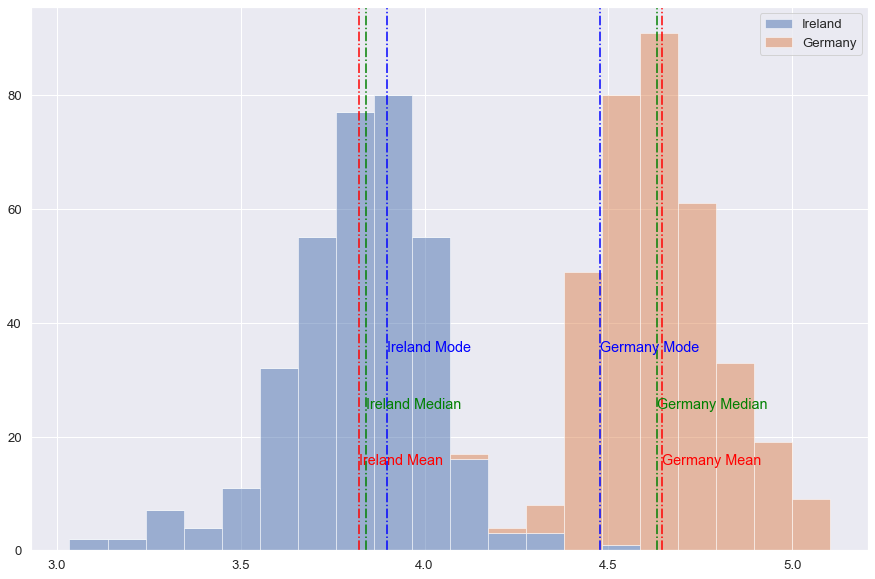

In [124]:
from statistics import median, mode

plt.figure(figsize=(15,10))
normal = (np.log(beef[['Ireland', 'Germany']]).replace([np.inf, -np.inf]))

plt.axvline(normal['Ireland'].mean(), color='red', linestyle='-.')
plt.text(normal['Ireland'].mean(), 15, 'Ireland Mean', color='red')
plt.axvline(median(normal['Ireland']), color='green', linestyle='-.')
plt.text(median(normal['Ireland']),25, 'Ireland Median', color='green')
plt.axvline(mode(normal['Ireland']), color='blue', linestyle='-.')
plt.text(mode(normal['Ireland']),35, 'Ireland Mode', color='blue')

plt.axvline(normal['Germany'].mean(), color='red', linestyle='-.')
plt.text(normal['Germany'].mean(), 15, 'Germany Mean', color='red')
plt.axvline(median(normal['Germany']), color='green', linestyle='-.')
plt.text(median(normal['Germany']),25, 'Germany Median', color='green')
plt.axvline(mode(normal['Germany']), color='blue', linestyle='-.')
plt.text(mode(normal['Germany']),35, 'Germany Mode', color='blue')


plt.hist((np.log(beef[['Ireland', 'Germany']]).replace([np.inf, -np.inf])), 
         label=['Ireland', 'Germany'], stacked=True, bins=20, alpha=0.5)
plt.legend(loc=0)
plt.show()

## Normal Distribution Probability Prediction

In [125]:
# Normal Distribution Probablity Prediction
mean = normal[['Ireland']].mean()
std = normal[['Ireland']].std()
  
probability_pdf = norm.pdf(3.83, loc=mean, scale=std)
print(probability_pdf)

[1.99767935]


# Data PreProcessing

In [126]:
data = fn.dataProcessing(irelandAllData.copy(), 'Ireland Bovine Meat', 12)
data.targetIntoLast()
data.addMonth()
data.highLow()
data.movingAverage()
data.removeOutliers()
data.data

,Month,Ireland GDP,Ireland GDP Per Capita,Ireland Carcass Yield,Ireland Population,Export Quantity,Import Quantity,Ireland Surplus,Price,Ireland Pig Meat,High,Low,MovingAverage,Ireland Lamb Meat,Ireland Bovine Meat
1992-01-01,1,76486482000.0000,11727.6453,3309.0000,3558430.0000,71485.0000,6630.0000,64855.0000,2.5150,17.9000,NaN,NaN,NaN,6.5000,35.0000
1992-02-01,2,76658105500.0000,11800.6422,3308.5000,3559915.9167,72090.0833,6511.4167,65578.6667,2.4650,15.0000,NaN,NaN,NaN,5.3000,31.9000
1992-03-01,3,76829729000.0000,11873.6390,3308.0000,3561401.8333,72695.1667,6392.8333,66302.3333,2.4151,16.5000,NaN,NaN,NaN,4.7000,46.7000
1992-04-01,4,77001352500.0000,11946.6358,3307.5000,3562887.7500,73300.2500,6274.2500,67026.0000,2.3651,16.0000,NaN,NaN,NaN,5.9000,40.0000
1992-05-01,5,77172976000.0000,12019.6326,3307.0000,3564373.6667,73905.3333,6155.6667,67749.6667,2.3803,15.9000,NaN,NaN,NaN,7.9000,33.8000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-09-01,9,347254666666.6667,73943.3529,3359.3333,4974596.0000,35891.0000,6803.6667,29087.3333,5.0410,24.4600,61.0300,32.9700,51.1850,5.2800,32.9700
2019-10-01,10,348888500000.0000,74154.5104,3361.0000,4979628.0000,35510.7500,6883.5000,28627.2500,5.3036,26.2000,61.8200,32.9700,51.3950,6.6900,61.8200
2019-11-01,11,350522333333.3333,74365.6678,3362.6667,4984660.0000,35130.5000,6963.3333,28167.1667,5.0343,26.2900,61.8200,32.9700,51.3000,6.1200,59.8900
2019-12-01,12,352156166666.6667,74576.8253,3364.3333,4989692.0000,34750.2500,7043.1667,27707.0833,4.7650,23.6800,61.8200,32.9700,51.6508,5.8100,48.2500


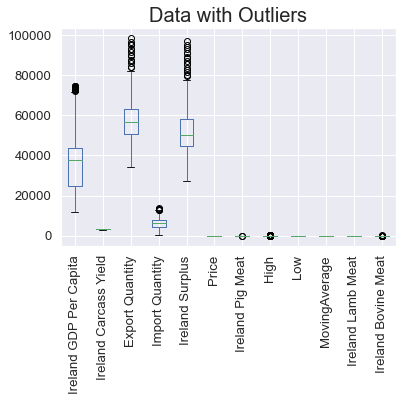

In [127]:
data.data.drop(columns=['Ireland GDP', 'Ireland Population']).plot(kind='box', rot=90)
plt.title('Data with Outliers', fontsize=20);

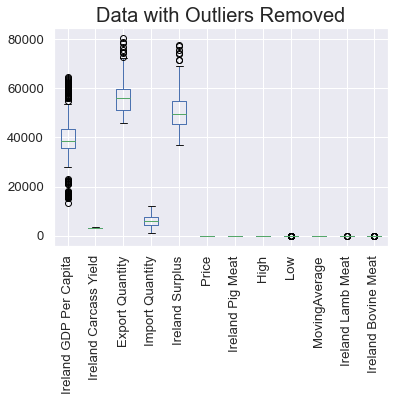

In [128]:
data.dataNoOutliers.drop(columns=['Ireland GDP', 'Ireland Population']).plot(kind='box', rot=90)
plt.title('Data with Outliers Removed', fontsize=20);

# Machine Learning Models

Now that the EDA and statistical analysis has been done now it is to see if the model can predict the bovine production.  New regression models never used before will be used. First will be to visually see PCA and KMeans for best inputs and then this will be put into the models and compared for supervised and semi supervised machine learning. 

## Import Regression Models

Regression models XGBRegressor, Support Vector Regressor, and Baysian Ridge will be used in conjunction with Polynomial Features.

In [129]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import BayesianRidge
from xgboost import XGBRegressor
from sklearn.svm import SVR

## SKLearn Libraries

SK Learn libraries will be imported to help get best results.  KNN imputer will be used to impute the dataset.  Standard, MinMax and Robust scaler to see which scaler is best.  Pipeline in conjunction with column transformer will be used to implement the other libraries mentioned before and preprocess the data. Gridsearch Cross Validation will use to pick the best hyperparameters for the model.  Finally metrics will be imported to validate results of the models. 

In [130]:
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder, RobustScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import make_pipeline
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error
from collections import Counter

## Parameter Dictionaries

I found that using dictionaries was much easier to input and see settings to iterate over.  This was the best way I could think of to iterate in Grid Search CV all the different parameters along with models, estimators, and scalers. 

In [131]:
regressors = {'XGBRegressor': XGBRegressor,
              'PolynomialFeatures': PolynomialFeatures,
              'SVR': SVR, 'Bayesian': BayesianRidge}

parameters = {'SVR': {'gridParams':
                    {'svr__C': [1, 10, 100, 1000],
                    'svr__gamma': [0.1, 0.001, 0.0001]}},
              'Bayesian': {'gridParams': 
                        {'bayesianridge__alpha_init':[1, 1.1, 1.2, 1.3, 1.4, 1.5, 1.9],
                          'bayesianridge__lambda_init': [1e-1, 1e-2, 1e-3, 1e-4, 1e-5, 1e-6, 1e-9],
                         'bayesianridge__normalize': [True, False],
                         'bayesianridge__n_iter': [300, 400, 500, 1000]}},
             'XGBRegressor': {'gridParams': 
                    {'xgbregressor__max_depth': [2, 4, 6],
                    'xgbregressor__n_estimators': [50, 100, 200, 400, 500, 1000],
                    'xgbregressor__gamma': [0.01, 0.1, 1.0],
                    'xgbregressor__learning_rate': [0.001, 0.01, 0.1]}}, 
             'PolynomialFeatures': {'gridParams': 
                     {'polynomialfeatures__degree': [2, 3],
                                    'bayesianridge__alpha_init':[1, 1.1, 1.2, 1.3, 1.4, 1.5, 1.9],
                                      'bayesianridge__lambda_init': [1e-1, 1e-2, 1e-3, 1e-4, 1e-5, 1e-6, 1e-9],
                                     'bayesianridge__normalize': [True, False],
                                     'bayesianridge__n_iter': [300, 400, 500, 1000]}}}

addEstimators = {'PCA': PCA(n_components=0.95), 'KMeans': KMeans(n_clusters=5),'None': None}

scalers = {'Standard Scaler': StandardScaler(),
          'Min Max Scaler': MinMaxScaler(),
          'Robust Scaler': RobustScaler()}

## PCA Number of Components

Going through the dataset prior to going to train the models to see what is the best number of dimensions for the model.  Had to prepare the X, and y and the found that 0.95 in number of components captures the 95% of the data's variance.  This is the setting put into all models and there were improvement in XGBoost performance with PCA.

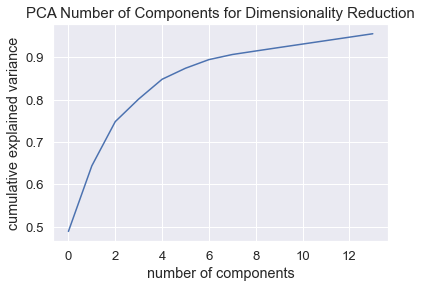

In [132]:
X, y = data.data.iloc[:, :-1], data.data.iloc[:, -1]

num_cols = X.select_dtypes(exclude=['object']).columns.tolist()
cat_cols = X.select_dtypes(include=['object']).columns.tolist()

sca = RobustScaler()
imputer = KNNImputer(n_neighbors=3)
encoder = OneHotEncoder(handle_unknown='ignore').fit(X[cat_cols])

X_transformed = pd.DataFrame(data=imputer.fit_transform(X[num_cols]), columns=num_cols)
X_transformed = pd.DataFrame(data=sca.fit_transform(X_transformed[num_cols]), columns=num_cols)
X_encoded = pd.DataFrame(data=encoder.transform(X[cat_cols]).toarray(), columns=encoder.get_feature_names())

X_transformed = pd.concat([X_transformed, X_encoded], axis=1)

pca = PCA(n_components=0.95).fit(X_transformed)
pca_transformed = pca.fit_transform(X_transformed)

plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.title('PCA Number of Components for Dimensionality Reduction', fontsize=15)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');

## K-Means Number of Clusters Elbow

Now to find the number of clusters best fit for this dataset using the elbow method.

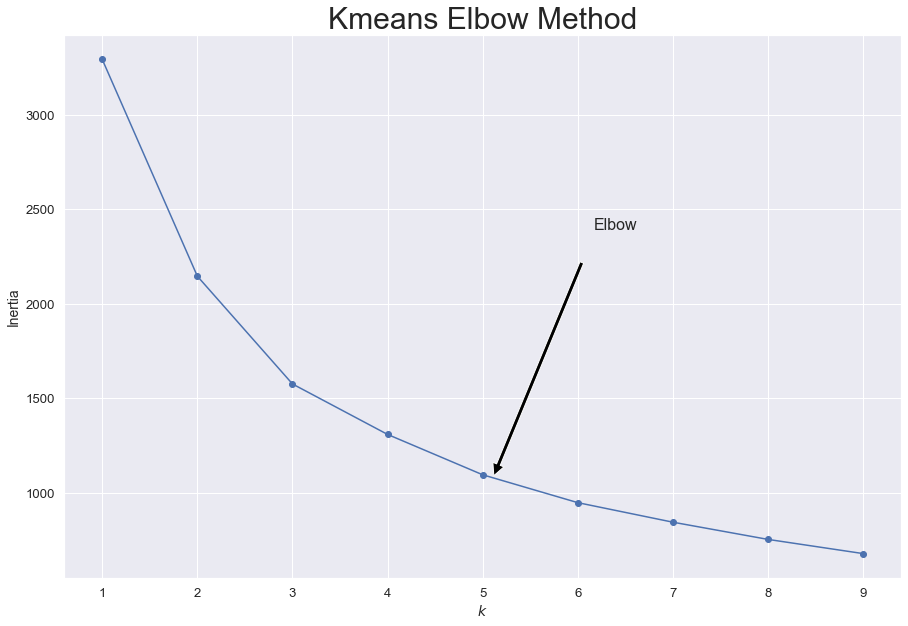

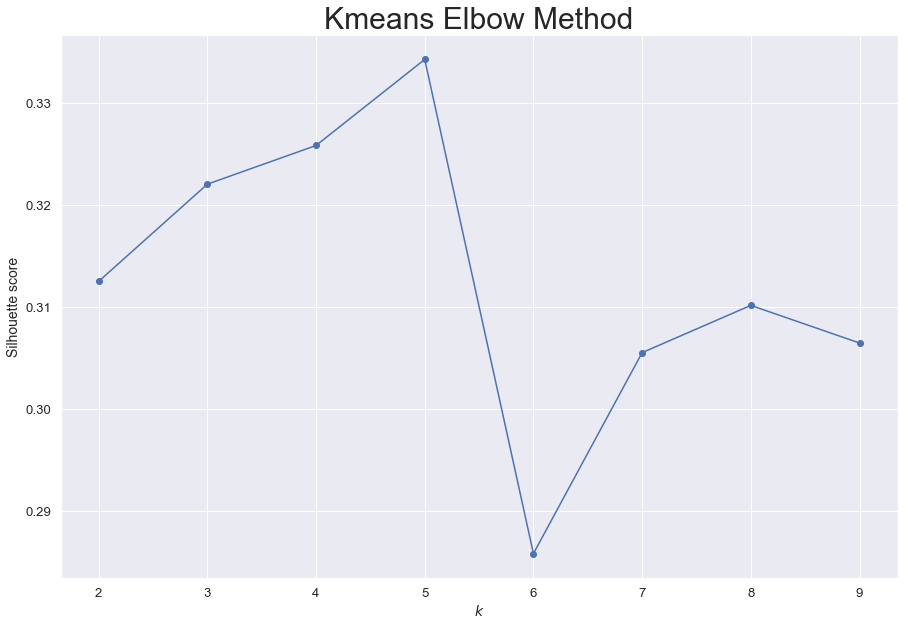

In [133]:
kMeans_inertia = pd.DataFrame(data=[],index=range(2,21), columns=['inertia'])
for n_clusters in range(2,21):
    kmeans = KMeans(n_clusters=n_clusters)
    cutoff = 99
    kmeans.fit(pca_transformed[:,0:cutoff])
    kMeans_inertia.loc[n_clusters] = kmeans.inertia_
    
kmeans_per_k = [KMeans(n_clusters=k).fit(pca_transformed)
                for k in range(1, 10)]
inertias = [model.inertia_ for model in kmeans_per_k]

plt.figure(figsize=(15, 10))
plt.plot(range(1, 10), inertias, "bo-")
plt.xlabel("$k$", fontsize=14)
plt.ylabel("Inertia", fontsize=14)
plt.annotate('Elbow',
             xy=(5, inertias[5]),
             xytext=(0.55, 0.55),
             textcoords='figure fraction',
             fontsize=16,
             arrowprops=dict(facecolor='black', shrink=0.1))
plt.title('Kmeans Elbow Method', fontsize=30)
plt.show()

from sklearn.metrics import silhouette_score
silhouette_scores = [silhouette_score(pca_transformed, model.labels_)
                     for model in kmeans_per_k[1:]]

plt.figure(figsize=(15, 10))
plt.plot(range(2, 10), silhouette_scores, "bo-")
plt.title('Kmeans Elbow Method', fontsize=30)
plt.xlabel("$k$", fontsize=14)
plt.ylabel("Silhouette score", fontsize=14)
plt.show()

## Regression Models

### Run Models with Outliers

In [135]:
X, y = data.data.iloc[:, :-1], data.data.iloc[:, -1]
resultsOutliers = fn.Models().runModels(regressors, parameters, addEstimators, scalers, X, y, 'Outliers')

Model XGBRegressor
Result for this model is 0.640811 % 
Completed 2.78% 

Model PolynomialFeatures
Result for this model is 0.721018 % 
Completed 5.56% 

Model SVR
Result for this model is 0.195338 % 
Completed 8.33% 

Model Bayesian
Result for this model is 0.396607 % 
Completed 11.11% 

Model XGBRegressor
Result for this model is 0.706004 % 
Completed 13.89% 

Model PolynomialFeatures
Result for this model is 0.706388 % 
Completed 16.67% 

Model SVR
Result for this model is 0.578364 % 
Completed 19.44% 

Model Bayesian
Result for this model is 0.547620 % 
Completed 22.22% 

Model XGBRegressor
Result for this model is 0.722884 % 
Completed 25.0% 

Model PolynomialFeatures
Result for this model is 0.761317 % 
Completed 27.78% 

Model SVR
Result for this model is 0.304478 % 
Completed 30.56% 

Model Bayesian
Result for this model is 0.405315 % 
Completed 33.33% 

Model XGBRegressor
Result for this model is 0.405524 % 
Completed 36.11% 

Model PolynomialFeatures
Result for this model is 

### Run Models Without Outliers

In [136]:
X, y = data.dataNoOutliers.iloc[:, :-1], data.dataNoOutliers.iloc[:, -1]
resultsNoOutliers = fn.Models().runModels(regressors, parameters, addEstimators, scalers, X, y, 'No Outliers')

Model XGBRegressor
Result for this model is 0.657746 % 
Completed 2.78% 

Model PolynomialFeatures
Result for this model is 0.741679 % 
Completed 5.56% 

Model SVR
Result for this model is 0.187154 % 
Completed 8.33% 

Model Bayesian
Result for this model is 0.413286 % 
Completed 11.11% 

Model XGBRegressor
Result for this model is 0.717768 % 
Completed 13.89% 

Model PolynomialFeatures
Result for this model is 0.699116 % 
Completed 16.67% 

Model SVR
Result for this model is 0.603075 % 
Completed 19.44% 

Model Bayesian
Result for this model is 0.575329 % 
Completed 22.22% 

Model XGBRegressor
Result for this model is 0.681591 % 
Completed 25.0% 

Model PolynomialFeatures
Result for this model is 0.793384 % 
Completed 27.78% 

Model SVR
Result for this model is 0.701742 % 
Completed 30.56% 

Model Bayesian
Result for this model is 0.473912 % 
Completed 33.33% 

Model XGBRegressor
Result for this model is 0.664181 % 
Completed 36.11% 

Model PolynomialFeatures
Result for this model is 

## All Model Results

In [137]:
outResults = pd.DataFrame(resultsOutliers)
noOutResults = pd.DataFrame(resultsNoOutliers)
allResults = pd.concat([outResults, noOutResults], axis=0)
allResults.sort_values(by='R2 Score', ascending=False, inplace=True)
allResults.reset_index(inplace=True, drop=True)
allResults.head(25)

,Model Name,Scaler,Outliers,Dimension Reducer,Best Parameters,R2 Score,Mean Square Error,Mean Absolute Error,Feature Importance,Dimension Reduction
0,SVR,Robust Scaler,No Outliers,None,"{'svr__C': 100, 'svr__gamma': 0.1}",0.9907,0.4744,0.2316,Not Available,Not Available
1,Polynomial Features Bayesian,Robust Scaler,Outliers,None,"{'bayesianridge__alpha_init': 1.9, 'bayesianri...",0.8697,10.2400,2.3688,Not Available,Not Available
2,Polynomial Features Bayesian,Standard Scaler,Outliers,None,"{'bayesianridge__alpha_init': 1.9, 'bayesianri...",0.8616,10.8761,2.4362,Not Available,Not Available
3,Polynomial Features Bayesian,Standard Scaler,No Outliers,None,"{'bayesianridge__alpha_init': 1.2, 'bayesianri...",0.8601,7.1198,2.0003,Not Available,Not Available
4,Polynomial Features Bayesian,Robust Scaler,No Outliers,None,"{'bayesianridge__alpha_init': 1.1, 'bayesianri...",0.8499,7.6378,2.0754,Not Available,Not Available
5,XGBRegressor,Robust Scaler,No Outliers,None,"{'xgbregressor__gamma': 0.01, 'xgbregressor__l...",0.8169,9.3190,2.2060,"[0.013652445748448372, 0.09160857647657394, 0....",Not Available
6,XGBRegressor,Min Max Scaler,No Outliers,None,"{'xgbregressor__gamma': 0.01, 'xgbregressor__l...",0.8169,9.3190,2.2060,"[0.013652445748448372, 0.09160857647657394, 0....",Not Available
7,XGBRegressor,Standard Scaler,No Outliers,None,"{'xgbregressor__gamma': 0.01, 'xgbregressor__l...",0.8169,9.3190,2.2060,"[0.013652445748448372, 0.09160857647657394, 0....",Not Available
8,Polynomial Features Bayesian,Min Max Scaler,Outliers,None,"{'bayesianridge__alpha_init': 1, 'bayesianridg...",0.7994,15.7718,2.9002,Not Available,Not Available
9,Polynomial Features Bayesian,Robust Scaler,No Outliers,PCA,"{'bayesianridge__alpha_init': 1.2, 'bayesianri...",0.7934,10.5167,2.4278,Not Available,"[[0.0013875480337519988, -0.003096926864362630..."


In [138]:
#allResults.to_csv('otherSpreadsheets/ModelResults22052022.csv', index=False)

# Model Result Plots

In [134]:
allResults =pd.read_csv('otherSpreadsheets/ModelResults22052022.csv')
allResults

,Model Name,Scaler,Outliers,Dimension Reducer,Best Parameters,R2 Score,Mean Square Error,Mean Absolute Error,Feature Importance,Dimension Reduction
0,SVR,Robust Scaler,No Outliers,None,"{'svr__C': 100, 'svr__gamma': 0.1}",0.9907,0.4744,0.2316,Not Available,Not Available
1,Polynomial Features Bayesian,Robust Scaler,Outliers,None,"{'bayesianridge__alpha_init': 1.9, 'bayesianri...",0.8697,10.2400,2.3688,Not Available,Not Available
2,Polynomial Features Bayesian,Standard Scaler,Outliers,None,"{'bayesianridge__alpha_init': 1.9, 'bayesianri...",0.8616,10.8761,2.4362,Not Available,Not Available
3,Polynomial Features Bayesian,Standard Scaler,No Outliers,None,"{'bayesianridge__alpha_init': 1.2, 'bayesianri...",0.8601,7.1198,2.0003,Not Available,Not Available
4,Polynomial Features Bayesian,Robust Scaler,No Outliers,None,"{'bayesianridge__alpha_init': 1.1, 'bayesianri...",0.8499,7.6378,2.0754,Not Available,Not Available
5,XGBRegressor,Robust Scaler,No Outliers,None,"{'xgbregressor__gamma': 0.01, 'xgbregressor__l...",0.8169,9.3190,2.2060,[0.013652445748448372 0.09160857647657394 0.08...,Not Available
6,XGBRegressor,Min Max Scaler,No Outliers,None,"{'xgbregressor__gamma': 0.01, 'xgbregressor__l...",0.8169,9.3190,2.2060,[0.013652445748448372 0.09160857647657394 0.08...,Not Available
7,XGBRegressor,Standard Scaler,No Outliers,None,"{'xgbregressor__gamma': 0.01, 'xgbregressor__l...",0.8169,9.3190,2.2060,[0.013652445748448372 0.09160857647657394 0.08...,Not Available
8,Polynomial Features Bayesian,Min Max Scaler,Outliers,None,"{'bayesianridge__alpha_init': 1, 'bayesianridg...",0.7994,15.7718,2.9002,Not Available,Not Available
9,Polynomial Features Bayesian,Robust Scaler,No Outliers,PCA,"{'bayesianridge__alpha_init': 1.2, 'bayesianri...",0.7934,10.5167,2.4278,Not Available,[[ 1.38754803e-03 -3.09692686e-03 3.19847873e...


In [135]:
allResults[['Model Name', 'R2 Score']].groupby(by='Model Name').mean().sort_values('R2 Score', ascending=False).iplot(kind='bar');

In [136]:
allResults[['Scaler', 'R2 Score']].groupby(by='Scaler').mean().sort_values('R2 Score', ascending=False).iplot(kind='bar');

In [137]:
allResults[['Outliers', 'R2 Score']].groupby(by='Outliers').mean().sort_values('R2 Score', ascending=False).iplot(kind='bar');

In [138]:
allResults[['Dimension Reducer', 'R2 Score']].groupby(by='Dimension Reducer').mean().sort_values('R2 Score', ascending=False).iplot(kind='bar');

# Time Series Cross Validation Vs. Standard Cross Validation

In [139]:
allResultsTimeSeries = pd.read_csv('otherSpreadsheets/ModelResults22052022.csv')
allResultsTimeSeries = allResultsTimeSeries[allResultsTimeSeries['R2 Score'] > 0.50]
allResultsTimeSeries[['Model Name', 'R2 Score']].groupby(by='Model Name').mean().sort_values('R2 Score', 
                    ascending=False).iplot(kind='bar',title= 'Models With TimeSeries Cross Validation',
                    theme='ggplot');

In [140]:
allResultsTimeSeries.shape

(41, 10)

In [141]:
allResults = pd.read_csv('otherSpreadsheets/ModelResults19052022.csv')
allResults = allResults[allResults['R2 Score'] > 0.50]
allResults[['Model Name', 'R2 Score']].groupby(by='Model Name').mean().sort_values('R2 Score', 
                    ascending=False).iplot(kind='bar',title='Models With Standard Cross Validation', theme='ggplot');

In [142]:
allResults.shape

(40, 10)

# Dashboards

In [143]:
from explainerdashboard import RegressionExplainer, ExplainerDashboard, ExplainerHub
from sklearn.ensemble import RandomForestRegressor

## Prepare data for dashboards and models

In [144]:
X, y = data.data.iloc[:, :-1], data.data.iloc[:, -1]

num_cols = X.select_dtypes(exclude=['object']).columns.tolist()
cat_cols = X.select_dtypes(include=['object']).columns.tolist()

sca = RobustScaler()
imputer = KNNImputer(n_neighbors=3)
encoder = OneHotEncoder(handle_unknown='ignore').fit(X[cat_cols])

X_transformed = pd.DataFrame(data=imputer.fit_transform(X[num_cols]), columns=num_cols)
X_transformed = pd.DataFrame(data=sca.fit_transform(X_transformed[num_cols]), columns=num_cols)
X_encoded = pd.DataFrame(data=encoder.transform(X[cat_cols]).toarray(), columns=encoder.get_feature_names())

X_transformed = pd.concat([X_transformed, X_encoded], axis=1)
# Polynomial Transformer
polyTransformer = PolynomialFeatures(degree=2)
featuresPoly = polyTransformer.fit_transform(X_transformed)

In [145]:
svr = SVR(C=1000, gamma=0.001)
svr.fit(X_transformed,y)

brr = BayesianRidge(alpha_init=1, lambda_init=0.1, n_iter=300, normalize=True)
brr.fit(X_transformed, y)

polybrr = BayesianRidge(alpha_init=1, lambda_init=0.001, n_iter=300, normalize=False)
polybrr.fit(featuresPoly, y)

xgb = XGBRegressor(gamma=0.1, learning_rate=0.1, max_depth=4, n_estimators=100)
xgb.fit(X_transformed, y)


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0.1, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.1, max_delta_step=0,
             max_depth=4, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=12,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None)

## Explainer Hub

In [146]:
import os
db1 = ExplainerDashboard(RegressionExplainer(xgb, X_transformed, y), title='XGBoost Regression')
db2 = ExplainerDashboard(RegressionExplainer(brr, X_transformed, y), title='Bayesian Ridge Regression')
db3 = ExplainerDashboard(RegressionExplainer(svr, X_transformed, y), title='Support Vector Machine Regression')
hub = ExplainerHub([db1, db2, db3], secret_key=os.environ.get('dcb34dca-d334-4aa5-b9d6-9d36efe2fac3'))

hub.run(port=8050)

Changing class type to XGBRegressionExplainer...
Generating self.shap_explainer = shap.TreeExplainer(model)
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
Generating layout...
Calculating shap values...
Calculating predictions...
Calculating residuals...
Calculating absolute residuals...
Calculating shap interaction values...
Reminder: TreeShap computational complexity is O(TLD^2), where T is the number of trees, L is the maximum number of leaves in any tree and D the maximal depth of any tree. So reducing these will speed up the calculation.
Generating xgboost model dump...
Calculating dependencies...
Calculating importances...
Calculating ShadowDecTree for each individual decision tree...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExpla

  0%|          | 0/337 [00:00<?, ?it/s]

Calculating predictions...
Calculating residuals...
Calculating absolute residuals...
Calculating dependencies...
Calculating importances...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...


Using random SECRET_KEY: c15d4cee-ecff-4092-8ee8-0b58e9f68c11, please set it on your app.config["SECRET_KEY"]


Reminder, you can set ExplainerDashboard .name and .description in order to control the url path of the dashboard. Now defaulting to name=dashboard1 and default description...
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
Generating layout...
Calculating dependencies...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Reminder, you can set ExplainerDashboard .name and .description in order to control the url path of the dashboard. Now defaulting to name=dashboard2 and default description...
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is runnin

 * Running on all addresses.
 * Running on http://192.168.1.46:8050/ (Press CTRL+C to quit)
192.168.1.46 - - [22/May/2022 21:51:32] "GET / HTTP/1.1" 200 -
192.168.1.46 - - [22/May/2022 21:51:32] "GET /static/bootstrap.min.css HTTP/1.1" 200 -
192.168.1.46 - - [22/May/2022 21:51:32] "GET /static/jquery-3.5.1.slim.min.js HTTP/1.1" 304 -
192.168.1.46 - - [22/May/2022 21:51:32] "GET /static/bootstrap.min.js HTTP/1.1" 304 -
192.168.1.46 - - [22/May/2022 21:51:32] "GET /index/ HTTP/1.1" 200 -
192.168.1.46 - - [22/May/2022 21:51:32] "GET /index/assets/bootstrap.min.css?m=1647363557.60378 HTTP/1.1" 200 -
192.168.1.46 - - [22/May/2022 21:51:32] "GET /index/_dash-component-suites/dash/dcc/dash_core_components.v2_3_0m1647363514.js HTTP/1.1" 200 -
192.168.1.46 - - [22/May/2022 21:51:34] "GET /index/_dash-dependencies HTTP/1.1" 200 -
192.168.1.46 - - [22/May/2022 21:51:34] "GET /index/_dash-layout HTTP/1.1" 200 -
192.168.1.46 - - [22/May/2022 21:51:37] "GET /dashboards/_dashboard1 HTTP/1.1" 200 -
19

In [ ]:
ExplainerDashboard.terminate(8050)

## Dash Dashboard

In [147]:
from dash import Dash, dcc, html, Input, Output, dash
import plotly.graph_objects as go

app = Dash(__name__)

models = {'Suppor Vector Machine': SVR(C=1000, gamma=0.001),
        'Bayesian Ridge': BayesianRidge(alpha_init=1, lambda_init=0.1, n_iter=300, normalize=True),
          'PolyRidge': BayesianRidge(alpha_init=1, lambda_init=0.001, n_iter=300, normalize=False),
         'XGB Boost': XGBRegressor(gamma=0.1, learning_rate=0.1, max_depth=4, n_estimators=100)}

app.layout = html.Div([
    html.H4("Predicting Ireland's Monthly Beef Production"),
    html.P("Select model:"),
    dcc.Dropdown(
        id='dropdown',
        options=["Suppor Vector Machine", "Bayesian Ridge", "PolyRidge", "XGB Boost"],
        value='Suppor Vector Machine',
        clearable=False),
    dcc.Graph(id="graph")])

@app.callback(
    Output("graph", "figure"), 
    Input('dropdown', "value"))

def train_and_display(name):
    model = models[name]
    if name == 'PolyRidge':
        model.fit(featuresPoly, y)
    else:
        model.fit(X_transformed, y)

    showAmount = len(X) - 120
    y_pred = model.predict(X_transformed[showAmount:])

    fig = go.Figure([
        go.Scatter(x=X.index[showAmount:], y=y[showAmount:], 
                   name='Actual', mode='markers'),
        go.Scatter(x=X.index[showAmount:], y=y_pred, 
                   name='Prediction')])
    return fig

app.run_server(debug=True, use_reloader=False)

Dash is running on http://127.0.0.1:8050/

 * Serving Flask app '__main__' (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: on
